# EMRI Waveforms in Fourier Domain
Here we show how the plots of the paper have been produced

In [10]:
!ls

alpha_bounds.pdf
bf_mcmc.sh
BFoutput_Tobs2_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.001_dev7_nwalkers64_ntemps1_nsteps500000.txt
covariance.npy
lakshmi_mcmc.sh
mcmc_BF.py
MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0.txt
MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0.txt
MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0.txt
MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0.txt
MCMC_M5e+05_mu1e+01_p1.2e+01_e0.4_x1.0_T2.0.txt
mcmc.py
old_results_mcmc
output_Tobs2_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.1_x01.0_charge0.0_dev7_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev2_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M5e5_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev3_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M5e5_mu5_a0.95_p013.0_e00.4_x01.0_charge0.0_dev4_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs4_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev1_nwalkers64_ntemps1_nsteps500000.txt
PlayGroundScalarWaveforms.ipynb

In [1]:
import sys, time, h5py,os
import matplotlib
import numpy as np
import matplotlib.pyplot as plt

import corner

import matplotlib as mpl

default_width = 5.78853 # in inches
default_ratio = (np.sqrt(5.0) - 1.0) / 2.0 # golden mean

mpl.rcParams.update({
    "text.usetex": True,
    "pgf.texsystem": 'pdflatex',
    "pgf.rcfonts": False,
    "font.family": "serif",
    "figure.figsize": [default_width, default_width * default_ratio],
})

## Import results

In [2]:
# fontsize label
fs_lab = 18
# legend
fs_leg = 14
# ticks
fs_ticks = 14

## Posterior comparison

In [3]:
from eryn.backends import HDFBackend
import h5py, glob

In [4]:
filename = "test/MCMC_BF_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_d0.001_T2.0_seed26011996_nw64_nt1_logprior.h5"
file  = HDFBackend(filename)
print(filename)
print(file.get_move_info())

test/MCMC_BF_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_d0.001_T2.0_seed26011996_nw64_nt1_logprior.h5
{'DistributionGenerateRJ_0': {'acceptance_fraction': array([[0.91345157, 0.90639909, 0.90235428, 0.91044389, 0.90390998,
        0.9121033 , 0.90432483, 0.90406555, 0.91500726, 0.91360714,
        0.91314043, 0.72049367, 0.91220701, 0.91288114, 0.90821406,
        0.91339971, 0.90930305, 0.85340178, 0.90308027, 0.88544908,
        0.90613981, 0.90935491, 0.91132545, 0.90639909, 0.90085045,
        0.91080689, 0.86475835, 0.90256171, 0.89711678, 0.91002904,
        0.91018461, 0.91132545, 0.90193943, 0.91469612, 0.90821406,
        0.90805849, 0.00803775, 0.03583281, 0.90572495, 0.89763535,
        0.91194773, 0.91148102, 0.91018461, 0.90759179, 0.90484339,
        0.90240614, 0.9100809 , 0.91096246, 0.8828044 , 0.0079859 ,
        0.913296  , 0.90914748, 0.91319228, 0.9097179 , 0.86989214,
        0.89442024, 0.90157644, 0.91386642, 0.91339971, 0.90753993,
        0.00368181, 0.88378967, 0.90

In [5]:

# Automated windowing procedure following Sokal (1989)
def auto_window(taus, c):
    m = np.arange(len(taus)) < c * taus
    if np.any(m):
        return np.argmin(m)
    return len(taus) - 1

def next_pow_two(n):
    i = 1
    while i < n:
        i = i << 1
    return i

def autocorr_func_1d(x, norm=True):
    x = np.atleast_1d(x)
    if len(x.shape) != 1:
        raise ValueError("invalid dimensions for 1D autocorrelation function")
    n = next_pow_two(len(x))

    # Compute the FFT and then (from that) the auto-correlation function
    f = np.fft.fft(x - np.mean(x), n=2 * n)
    acf = np.fft.ifft(f * np.conjugate(f))[: len(x)].real
    acf /= 4 * n

    # Optionally normalize
    if norm:
        acf /= acf[0]

    return acf

def autocorr_gw2010(y, c=5.0):
    f = autocorr_func_1d(np.mean(y, axis=0))
    taus = 2.0 * np.cumsum(f) - 1.0
    window = auto_window(taus, c)
    return taus[window]

def autocorr_new(y, c=5.0):
    f = np.zeros(y.shape[1])
    for yy in y:
        f += autocorr_func_1d(yy)
    f /= len(y)
    taus = 2.0 * np.cumsum(f) - 1.0
    window = auto_window(taus, c)
    return taus[window]


def get_autocorr_plot(to_check):
    n_dim  = to_check.shape[-1]
    plt.figure()
    for var in range(n_dim):
        y = to_check[:,:,var].T
        # Compute the estimators for a few different chain lengths
        N = np.exp(np.linspace(np.log(100), np.log(y.shape[1]), 10)).astype(int)
        gw2010 = np.empty(len(N))
        new = np.empty(len(N))
        for i, n in enumerate(N):
            gw2010[i] = autocorr_gw2010(y[:, :n])
            new[i] = autocorr_new(y[:, :n])

        # Plot the comparisons
        # plt.loglog(N, gw2010, "o-", label="G&W 2010")
        plt.loglog(N, new, "o-", label=f"new var{var}")

    plt.plot(N, N / 50.0, "--k", label=r"$\tau = N/50$")
    # plt.axhline(true_tau, color="k", label="truth", zorder=-100)
    plt.xlabel("number of samples, $N$")
    plt.ylabel(r"$\tau$ estimates")
    plt.legend(fontsize=14);
    plt.show()



In [6]:
# datasets = sorted(glob.glob('old_results_mcmc/*nt1.h5'))
datasets = sorted(glob.glob('results_mcmc/*.h5'))
print(datasets)
# pars_inj = sorted(glob.glob('old_results_mcmc/*nt1_injected*.npy'))
pars_inj = sorted(glob.glob('results_mcmc/*injected*.npy'))
print(pars_inj)

['results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt2_logprior.h5', 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw64_nt1_logprior.h5', 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5', 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5', 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.4_e0.1_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5', 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5', 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5', 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5', 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5']
['results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt2_logprior_injected_pars.npy', 'results_

In [7]:
datasets

['results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt2_logprior.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw64_nt1_logprior.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.4_e0.1_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5',
 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5',
 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5',
 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5',
 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5']

In [8]:
pars_inj

['results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt2_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw64_nt1_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.4_e0.1_x1.0_T2.0_seed26011996_nw64_nt1_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior_injected_pars.npy',
 'results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior_

results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt2_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.375, 0.5  , 0.25 , 0.25 , 0.75 , 0.125, 0.5  , 0.375, 0.125,
        0.25 , 0.625, 0.25 , 0.5  , 0.5  , 0.125, 0.25 , 0.25 , 0.625,
        0.375, 0.375, 0.375, 0.5  , 0.375, 0.875, 0.5  , 0.125, 0.25 ,
        0.375, 0.5  , 0.375, 0.625, 0.5  ],
       [0.25 , 0.625, 0.375, 0.25 , 0.5  , 0.375, 0.5  , 0.5  , 0.375,
        0.375, 0.375, 0.375, 0.25 , 0.375, 0.375, 0.25 , 0.625, 0.625,
        0.25 , 0.625, 0.375, 0.375, 0.5  , 0.25 , 0.5  , 0.5  , 0.25 ,
        0.625, 0.125, 0.75 , 0.5  , 0.5  ]])}}


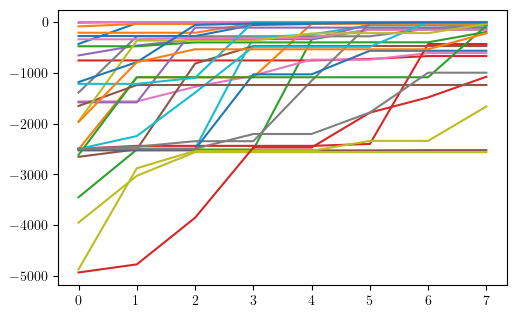

/tmp/ipykernel_4125766/3233601405.py:27: RuntimeWarning: invalid value encountered in divide
  acf /= acf[0]


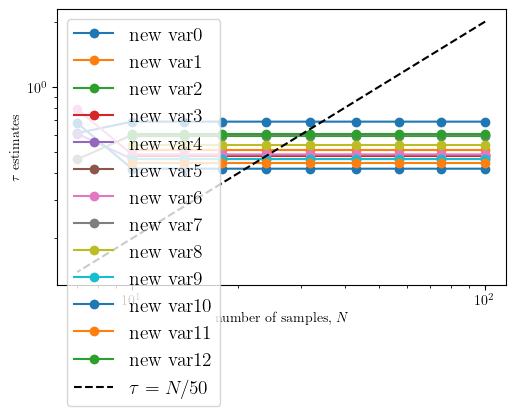

<Figure size 578.853x357.751 with 0 Axes>

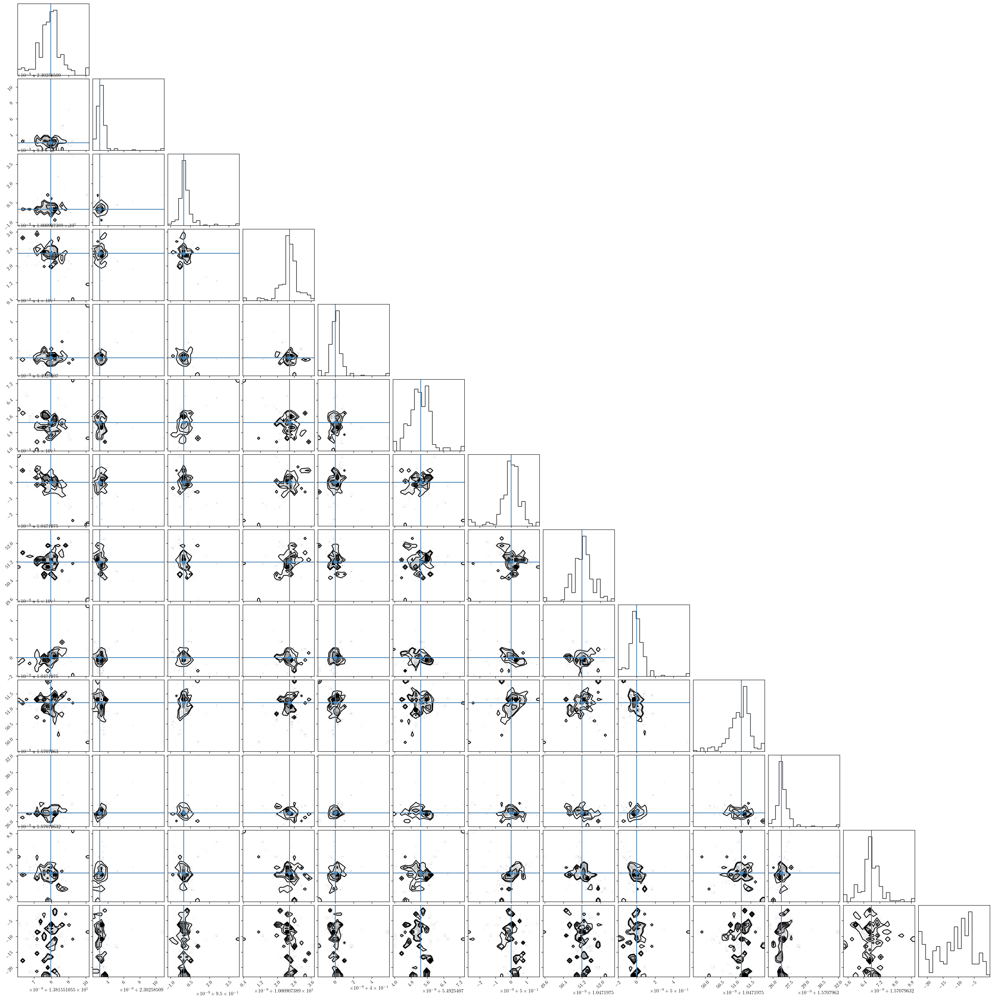

-0.035469638579606055
results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw64_nt1_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.18712439, 0.19632125, 0.10162083, 0.20224003, 0.19440903,
        0.1883992 , 0.19058459, 0.22855582, 0.21043526, 0.20324167,
        0.19240575, 0.20597341, 0.18985613, 0.19868876, 0.1996904 ,
        0.2036059 , 0.20570024, 0.19477327, 0.19741395, 0.17983974,
        0.19003824, 0.20897833, 0.19249681, 0.18084138, 0.10763067,
        0.19595702, 0.20606447, 0.18748862, 0.17892916, 0.20542706,
        0.1894919 , 0.19595702, 0.20697505, 0.17355673, 0.20023675,
        0.20451648, 0.21252959, 0.19531961, 0.18694227, 0.19450009,
        0.18821708, 0.19431797, 0.20114733, 0.18302677, 0.19641231,
        0.19258787, 0.01985066, 0.18211619, 0.20551812, 0.18985613,
        0.19859771, 0.18503005, 0.19932617, 0.21007103, 0.18849026,
        0.191222  , 0.19213258, 0.20114733, 0.20843198, 0.07075214,
        0.19040248, 0.183

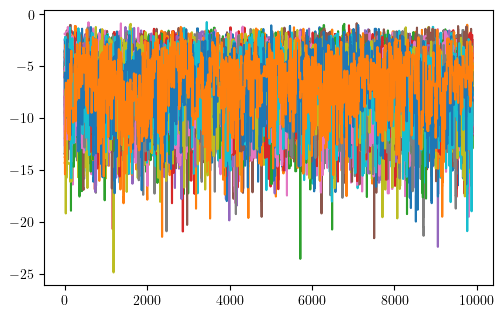

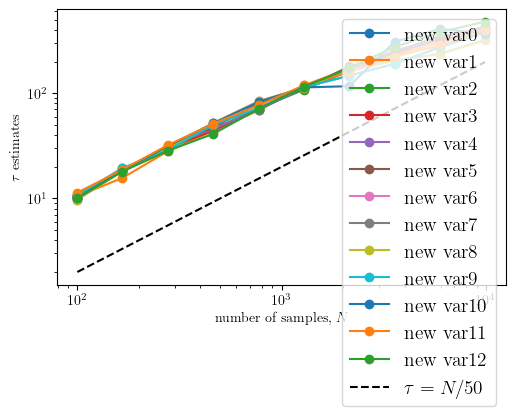

<Figure size 578.853x357.751 with 0 Axes>

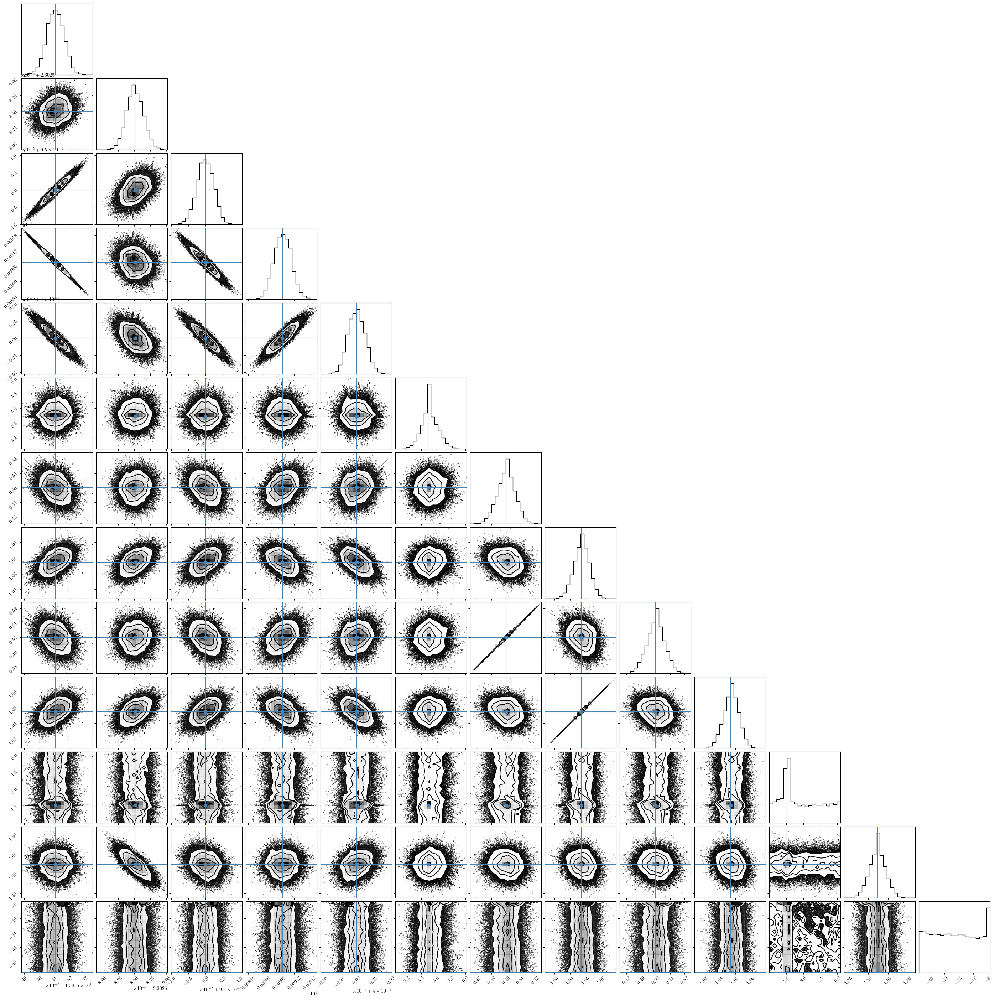

-6.620189329008678
results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.26247289, 0.22125813, 0.1626898 , 0.23210412, 0.21908894,
        0.21475054, 0.2472885 , 0.22125813, 0.23861171, 0.12581345,
        0.23861171, 0.23644252, 0.18438178, 0.20824295, 0.18221258,
        0.22342733, 0.27114967, 0.23427332, 0.20390456, 0.28199566,
        0.19305857, 0.19956616, 0.08893709, 0.2516269 , 0.24295011,
        0.24511931, 0.21041215, 0.26681128, 0.18221258, 0.18438178,
        0.24295011, 0.23644252],
       [0.1691974 , 0.18872017, 0.18438178, 0.18655098, 0.20173536,
        0.10629067, 0.164859  , 0.19305857, 0.164859  , 0.18221258,
        0.27982646, 0.20390456, 0.20824295, 0.2537961 , 0.1670282 ,
        0.23644252, 0.24295011, 0.19522777, 0.18872017, 0.22993492,
        0.20390456, 0.20607375, 0.15835141, 0.19088937, 0.17787419,
        0.19522777, 0.14967462, 0.22342733, 0.18655098, 0.2277657

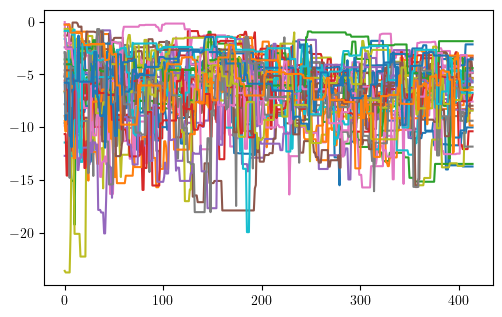

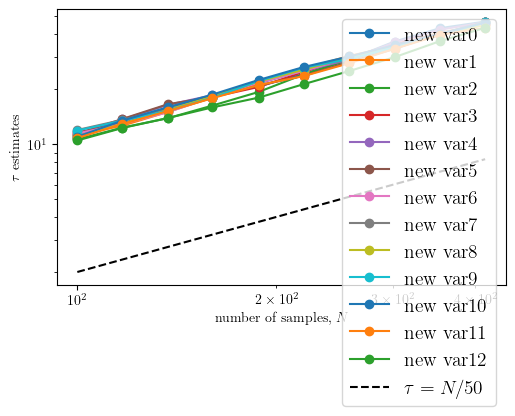

<Figure size 578.853x357.751 with 0 Axes>

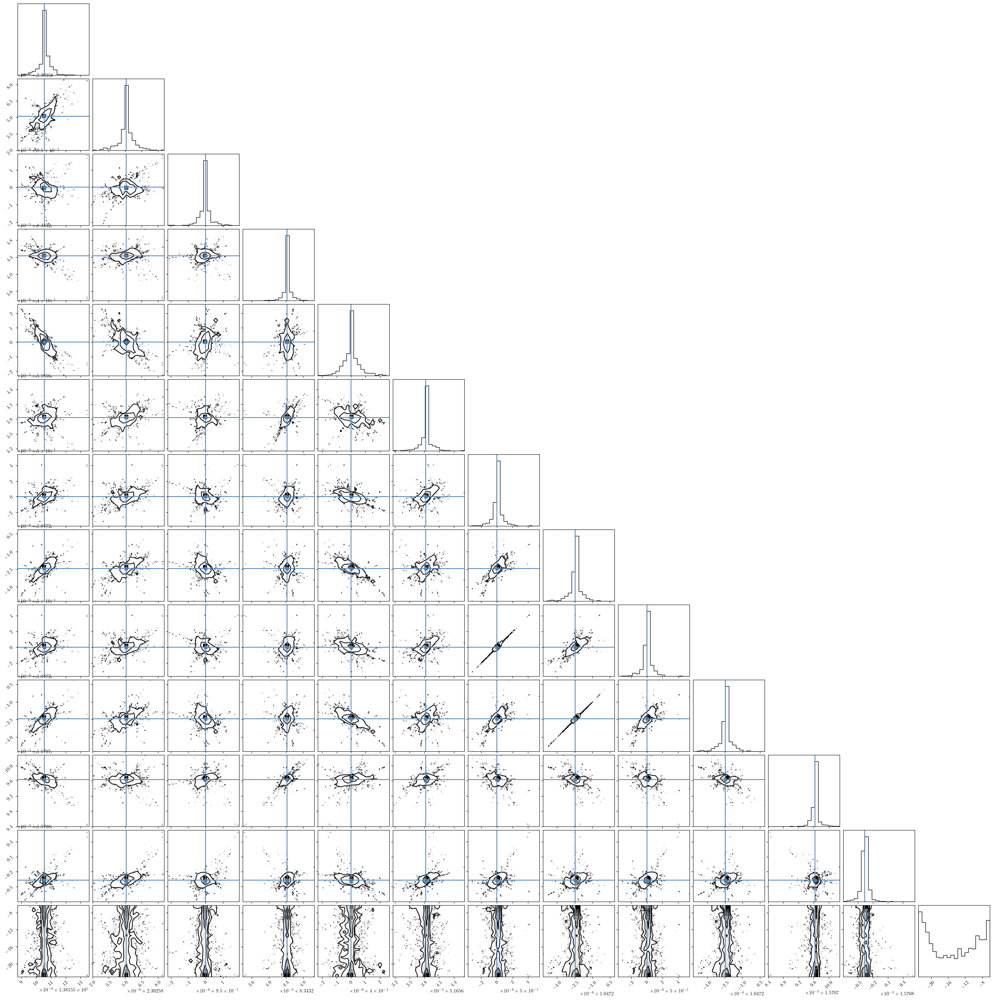

-6.258563787905775
results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.3_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.20021869, 0.20088689, 0.19420484, 0.21534443, 0.21157818,
        0.21449399, 0.1872798 , 0.20125137, 0.20040092, 0.20173733,
        0.20756895, 0.20811566, 0.19888227, 0.01233143, 0.22330215,
        0.19791034, 0.20720447, 0.20556433, 0.20811566, 0.21151743,
        0.19833556, 0.19025635, 0.20538209, 0.21333981, 0.1970599 ,
        0.21340056, 0.20216256, 0.21084923, 0.21194266, 0.20362046,
        0.19256469, 0.19353663, 0.20046167, 0.21066699, 0.20465314,
        0.1969384 , 0.21018102, 0.2090876 , 0.20665776, 0.20708298,
        0.20611104, 0.21115296, 0.20483538, 0.18928441, 0.19821407,
        0.19906451, 0.19663467, 0.18454623, 0.19541975, 0.19821407,
        0.18721905, 0.20635403, 0.21206415, 0.14493986, 0.20216256,
        0.19948973, 0.20264852, 0.21904993, 0.2113352 , 0.21546592,
        0.20720447, 0.19894302

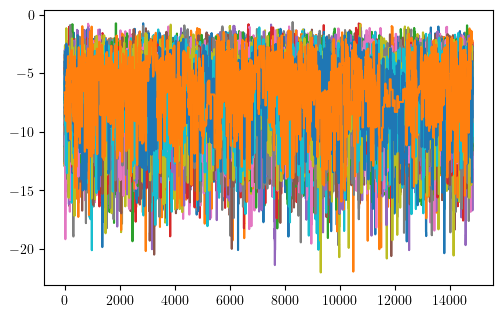

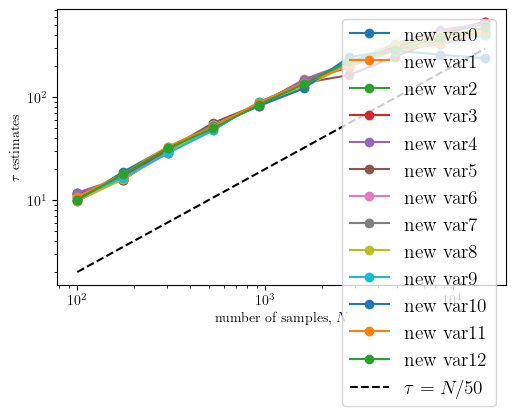

<Figure size 578.853x357.751 with 0 Axes>

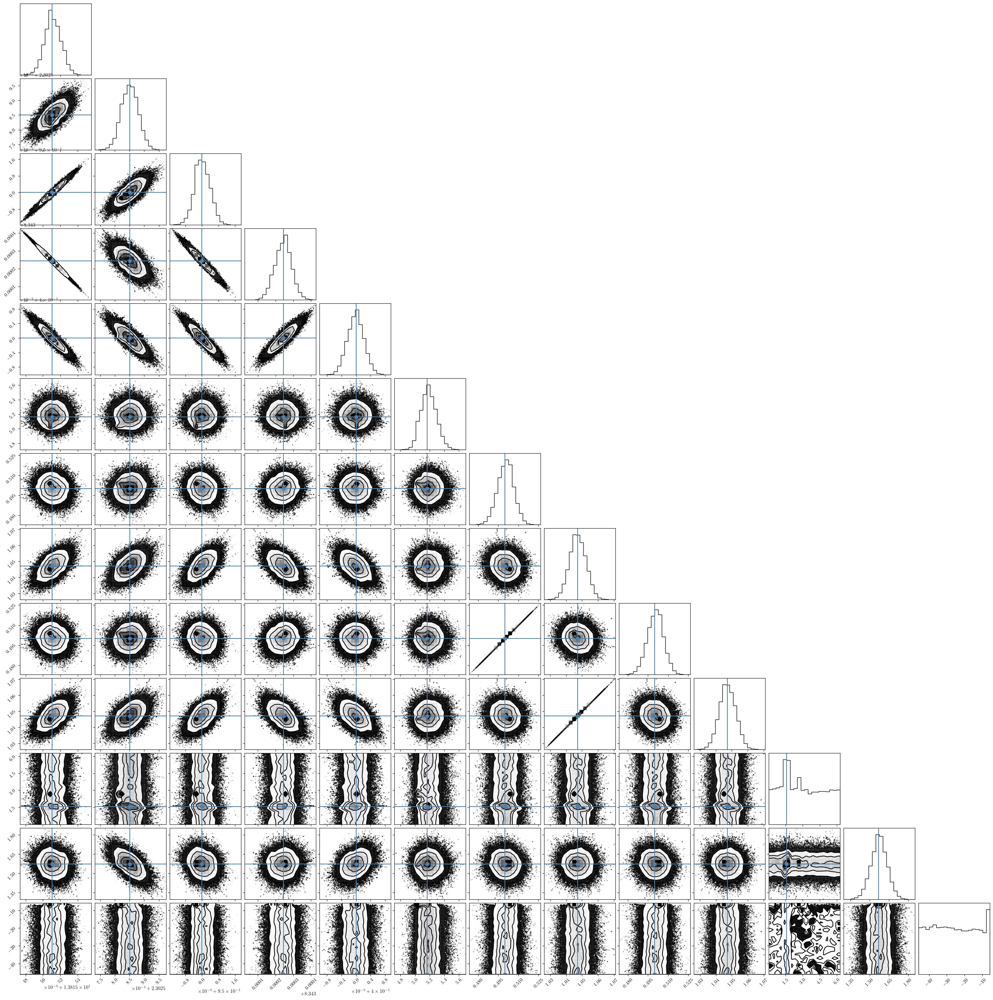

-5.856488138506311
results_mcmc/MCMC_M1e+06_mu1e+01_a0.95_p8.4_e0.1_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.19445026, 0.16393923, 0.19072532, 0.1712217 , 0.18633072,
        0.20051898, 0.1892186 , 0.03406856, 0.18972084, 0.17423513,
        0.18361026, 0.18603775, 0.19106014, 0.18863265, 0.19717072,
        0.19650107, 0.19675219, 0.19227389, 0.18875821, 0.17808563,
        0.19624995, 0.18821412, 0.19147868, 0.19101829, 0.19260871,
        0.17938308, 0.18557737, 0.18846524, 0.18093165, 0.19122756,
        0.1808898 , 0.18210354, 0.20252794, 0.18842339, 0.18570293,
        0.18779559, 0.18239652, 0.19876114, 0.0128071 , 0.19285983,
        0.1988867 , 0.19214833, 0.18691667, 0.18582849, 0.19001381,
        0.18666555, 0.18963713, 0.1872515 , 0.19750555, 0.20043527,
        0.19570586, 0.19273427, 0.18457289, 0.19147868, 0.18587034,
        0.1872515 , 0.20545767, 0.18009459, 0.18637258, 0.19796593,
        0.19139497, 0.18616331

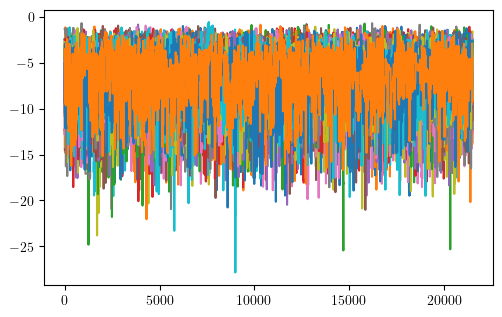

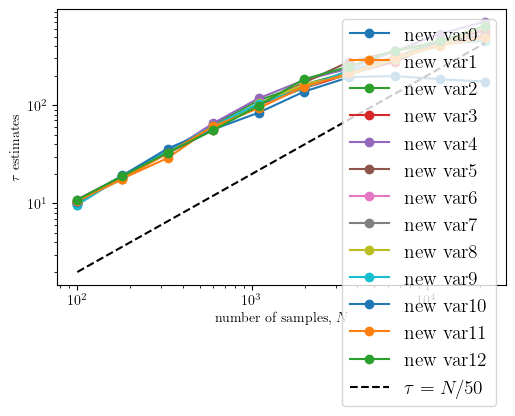

<Figure size 578.853x357.751 with 0 Axes>

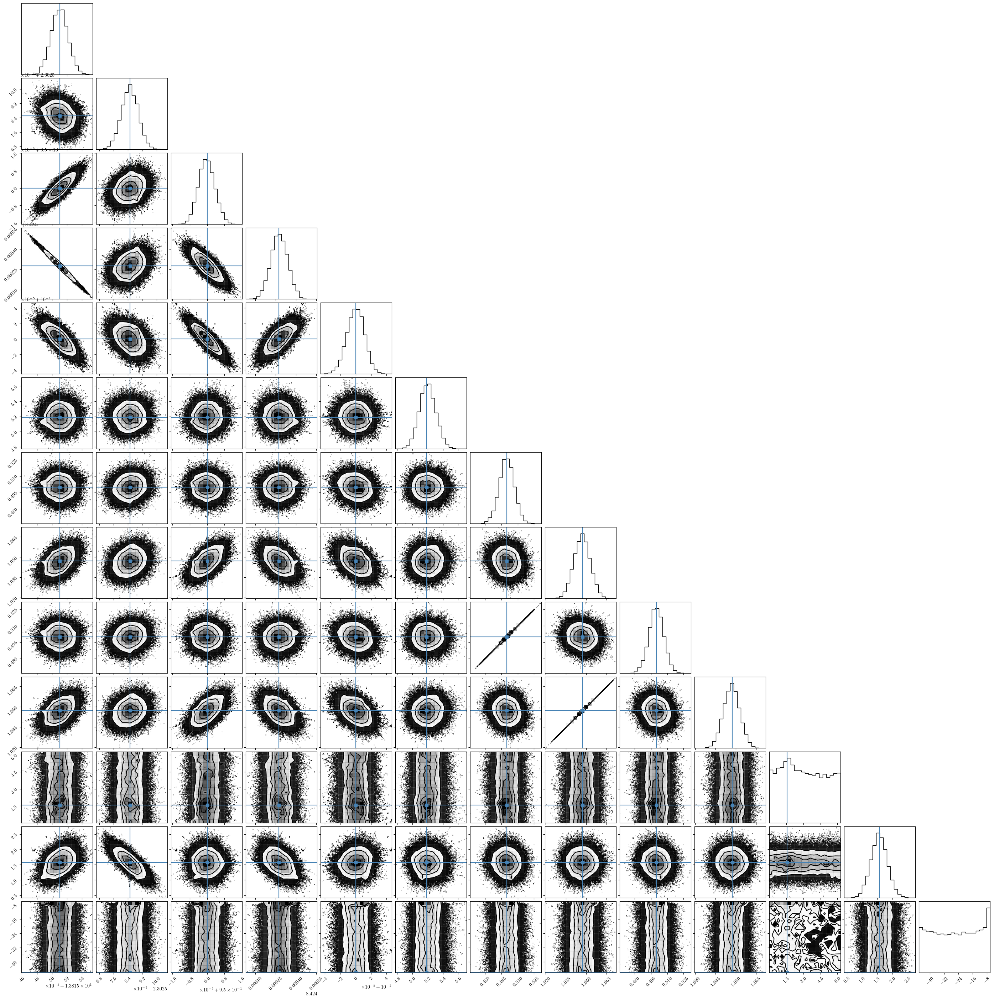

-6.067901542872232
results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.21328904, 0.22657807, 0.20930233, 0.15946844, 0.15548173,
        0.18006645, 0.26112957, 0.19800664, 0.2372093 , 0.15880399,
        0.24252492, 0.22790698, 0.1986711 , 0.1986711 , 0.19601329,
        0.23853821, 0.18538206, 0.23056478, 0.1461794 , 0.22059801,
        0.22724252, 0.18936877, 0.18604651, 0.09368771, 0.23388704,
        0.23122924, 0.26245847, 0.20598007, 0.25780731, 0.16677741,
        0.23920266, 0.20465116],
       [0.14219269, 0.14285714, 0.13754153, 0.15083056, 0.13156146,
        0.14152824, 0.13488372, 0.14352159, 0.13355482, 0.13156146,
        0.1448505 , 0.15614618, 0.14684385, 0.14219269, 0.1255814 ,
        0.14684385, 0.15215947, 0.14883721, 0.14219269, 0.16146179,
        0.13421927, 0.14817276, 0.15215947, 0.14817276, 0.15348837,
        0.12890365, 0.12026578, 0.14152824, 0.14817276, 0.152

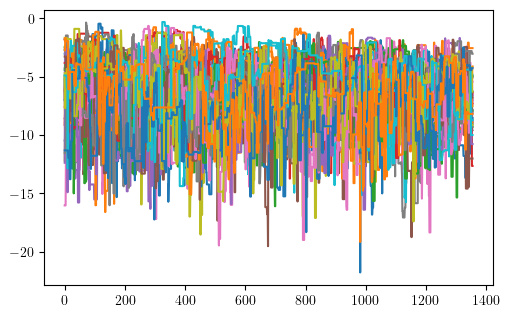

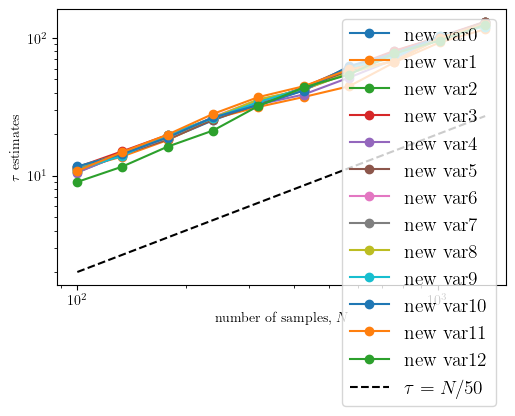

<Figure size 578.853x357.751 with 0 Axes>

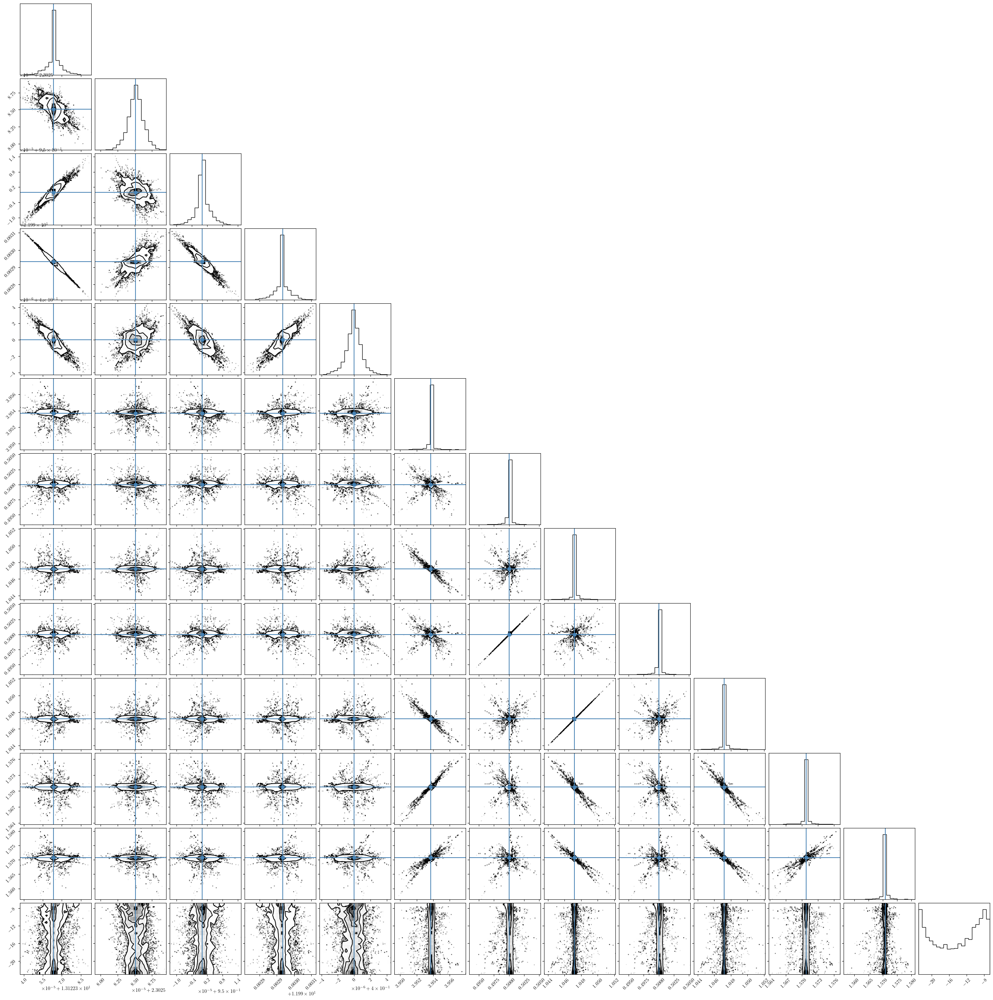

-6.773541624120762
results_mcmc/MCMC_M5e+05_mu1e+01_a0.95_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.19790446, 0.17460627, 0.20558376, 0.21345828, 0.21475986,
        0.21300273, 0.22256931, 0.19731876, 0.21710269, 0.21144084,
        0.17584277, 0.20109332, 0.21274242, 0.20311076, 0.20786151,
        0.19081088, 0.20981387, 0.20324092, 0.2072758 , 0.21443447,
        0.19862033, 0.20610439, 0.19894572, 0.20018222, 0.19822986,
        0.0208252 , 0.20688533, 0.20994403, 0.20577899, 0.20057269,
        0.21456462, 0.22439151, 0.19543147, 0.21235195, 0.19347911,
        0.20688533, 0.19790446, 0.1194195 , 0.19399974, 0.2023949 ,
        0.18970454, 0.19796954, 0.21000911, 0.21215671, 0.19725368,
        0.20174411, 0.21072498, 0.20603931, 0.22094234, 0.203306  ,
        0.21163608, 0.20799167, 0.19862033, 0.20499805, 0.20219966,
        0.20272029, 0.20174411, 0.21339321, 0.2085123 , 0.20285045,
        0.01672524, 0.2269

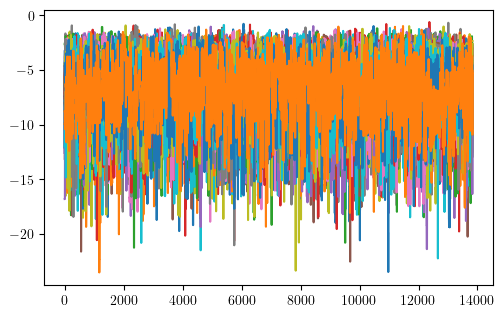

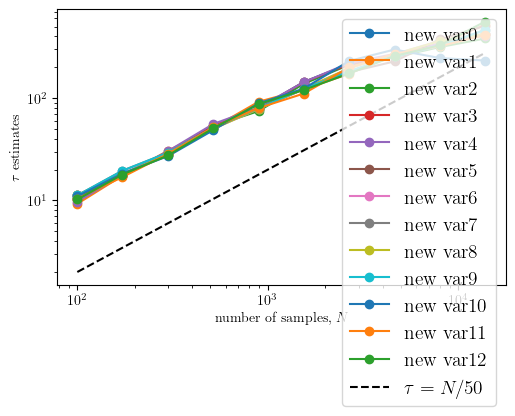

<Figure size 578.853x357.751 with 0 Axes>

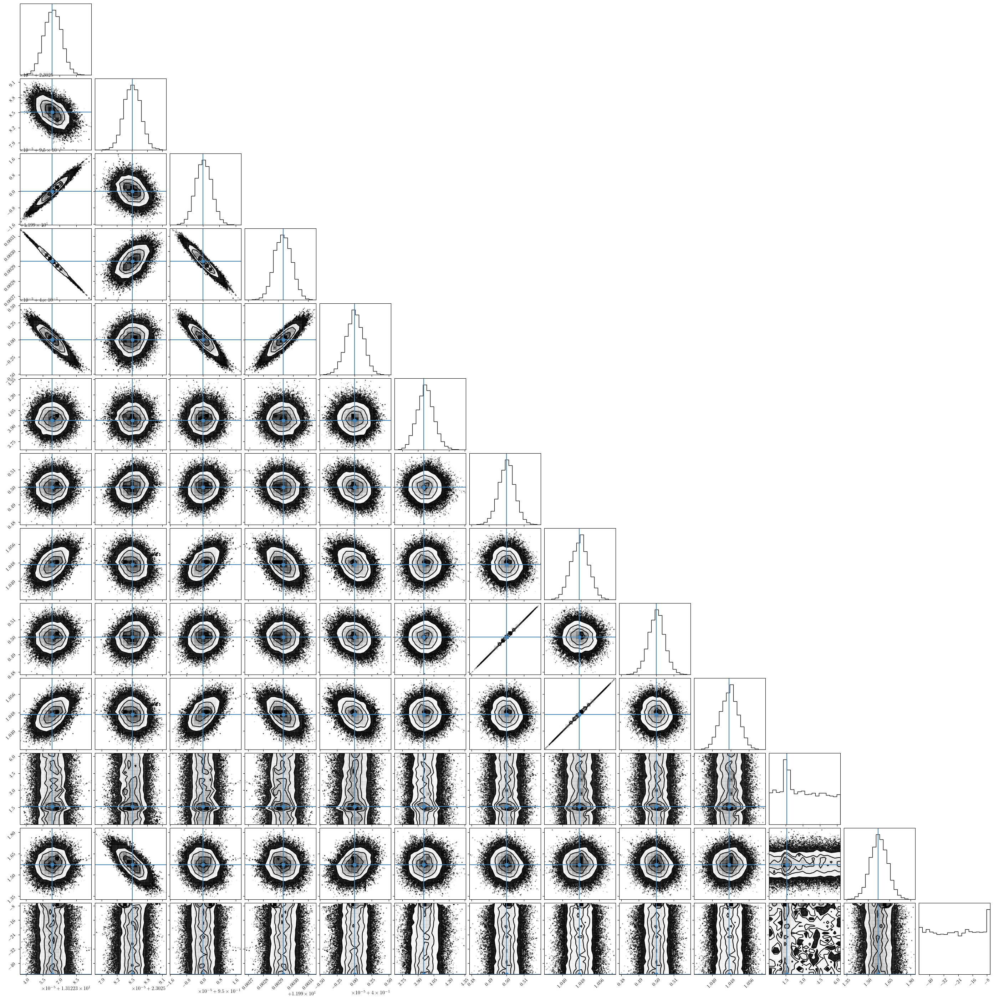

-6.359417081796855
results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt2_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.15204678, 0.25341131, 0.21442495, 0.25925926, 0.19688109,
        0.20077973, 0.2417154 , 0.18908382, 0.22612086, 0.15789474,
        0.23196881, 0.23196881, 0.22417154, 0.16569201, 0.25341131,
        0.10331384, 0.22222222, 0.22612086, 0.29044834, 0.31384016,
        0.16179337, 0.28460039, 0.24561404, 0.26510721, 0.28849903,
        0.22807018, 0.27680312, 0.22612086, 0.21052632, 0.21052632,
        0.29239766, 0.22417154],
       [0.21637427, 0.21052632, 0.18908382, 0.16179337, 0.18128655,
        0.11695906, 0.1754386 , 0.17933723, 0.19298246, 0.15789474,
        0.20662768, 0.21247563, 0.17153996, 0.21247563, 0.19688109,
        0.19688109, 0.19103314, 0.18518519, 0.23976608, 0.19103314,
        0.19688109, 0.18518519, 0.18128655, 0.20467836, 0.17933723,
        0.1539961 , 0.14424951, 0.17348928, 0.17348928, 0.1890838

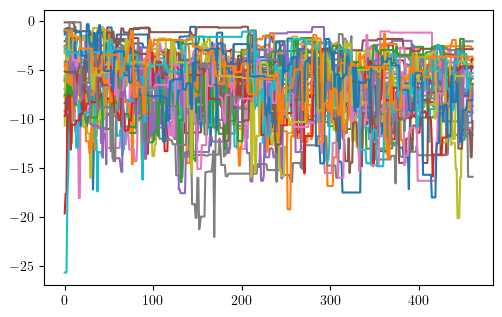

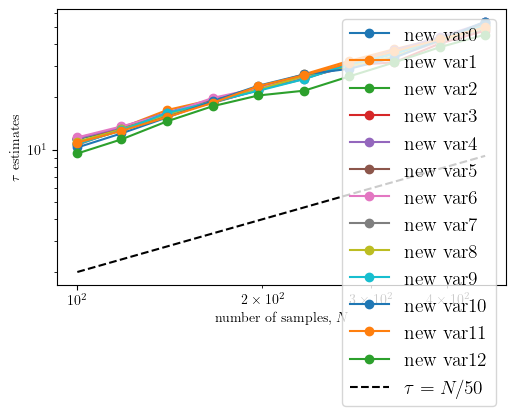

<Figure size 578.853x357.751 with 0 Axes>

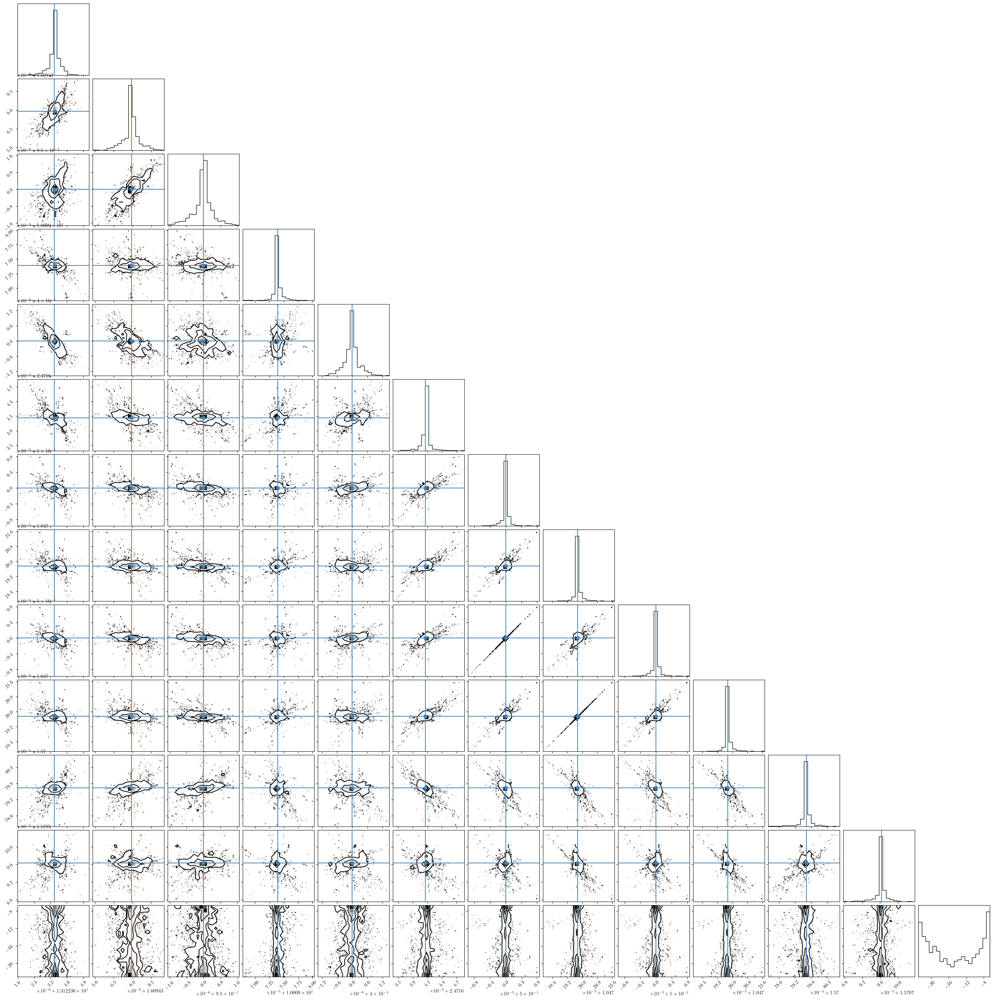

-6.6840241439002135
results_mcmc/MCMC_M5e+05_mu5.0_a0.95_p1e+01_e0.4_x1.0_T2.0_seed26011996_nw64_nt1_logprior.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.21010249, 0.21793558, 0.20849195, 0.22320644, 0.21581259,
        0.23382138, 0.20929722, 0.20929722, 0.23030747, 0.19721816,
        0.21156662, 0.211347  , 0.21412884, 0.22642753, 0.21691069,
        0.22650073, 0.22262079, 0.21961933, 0.22020498, 0.20863836,
        0.21991215, 0.21171303, 0.2193265 , 0.20775988, 0.21881406,
        0.22489019, 0.23038067, 0.21566618, 0.2375549 , 0.21661786,
        0.20959004, 0.02306003, 0.2102489 , 0.21859444, 0.2284041 ,
        0.21954612, 0.20783309, 0.22327965, 0.22708638, 0.22467057,
        0.21881406, 0.22240117, 0.21456808, 0.2306735 , 0.20915081,
        0.21742313, 0.2079063 , 0.23477306, 0.22027818, 0.2124451 ,
        0.22108346, 0.22335286, 0.18674963, 0.22298682, 0.22540264,
        0.21537335, 0.21676428, 0.22767204, 0.2       , 0.22606149,
        0.21537335, 0.2166910

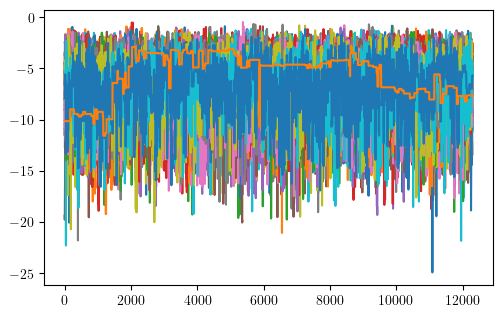

/tmp/ipykernel_4125766/3233601405.py:27: RuntimeWarning: invalid value encountered in divide
  acf /= acf[0]


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7fb241365240> (for post_execute):



KeyboardInterrupt



In [11]:
temp=0

samp_final = []
inj_pars = []
for filename,el in zip(datasets,pars_inj):
    file  = HDFBackend(filename)
    print(filename)
    print(file.get_move_info())
    max_iter = file.iteration
    burn = int(max_iter*0.1)
    thin = 1
    ll = file.get_log_like(discard=burn, thin=thin)
    mask = np.arange(32)#[file.get_move_info()['StretchMove_0']['acceptance_fraction'][0]>0.1]
    plt.figure()
    [plt.plot(ll[:,temp,walker],'-',label=f'{walker}') for walker in mask]
    plt.show()
    
    # get samples
    samp = file.get_chain(discard=burn, thin=thin)['emri'][:,temp,mask,...]
    inds = file.get_inds(discard=burn, thin=thin)['emri']
    toplot = samp[inds[:,temp,mask,...]]
    get_autocorr_plot(samp[:,:,0,:])
    logl = ll[:,temp,mask,...]

    truths = np.load(el)
    plt.figure(); corner.corner(toplot[:], truths=truths); plt.show()

    print(toplot[:,-1].max())
    samp_final.append(toplot)
    # samp_final.append( np.hstack((samp[inds[:,temp,mask,...]],logl[inds[:,temp,mask,0],None])) )
    inj_pars.append(truths)

(array([7134., 6490., 7500., 6504., 6495., 5892., 6139., 6076., 6533.,
        6629., 6224., 6899., 6331., 6304., 6468., 6191., 6635., 5908.,
        6276., 5828., 5996., 5949., 5955., 6211., 5966., 5949., 6026.,
        6074., 6117., 6458., 6038., 6019., 5965., 5735., 5824., 6161.,
        5819., 6117., 6143., 5849., 6025., 6321., 6024., 5638., 6148.,
        6231., 5920., 6080., 5709., 5873., 5974., 6016., 5532., 5708.,
        5791., 5613., 5740., 5722., 5262., 5455., 5650., 5923., 5664.,
        5971., 5837., 5612., 5947., 5874., 5845., 5611., 5959., 5585.,
        5460., 5542., 5519., 5962., 6019., 5966., 5663., 5683., 5748.,
        6318., 5857., 5707., 6018., 5705., 6095., 6351., 6000., 6317.,
        6278., 6066., 5874., 6306., 6013., 6059., 6598., 6440., 6213.,
        1573.]),
 array([-46.05153093, -45.66001397, -45.26849702, -44.87698006,
        -44.4854631 , -44.09394614, -43.70242919, -43.31091223,
        -42.91939527, -42.52787831, -42.13636136, -41.7448444 ,
        -4

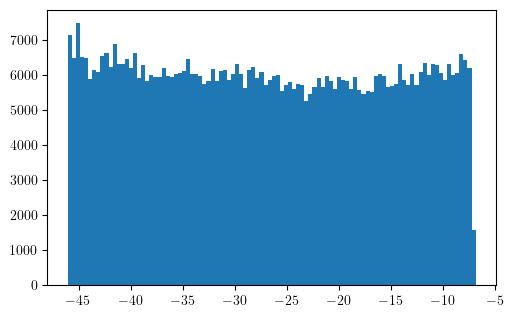

In [21]:
plt.hist(samp_final[-1][:,-1],bins=100)

In [10]:
# np.load('covariance.npy')
# np.save('covariance.npy',np.cov(samp_final[2][:,:-1].T))

(array([ 98., 100., 108.,  90.,  86., 111.,  97., 104.,  90., 116.]),
 array([-46.00176772, -41.47579581, -36.9498239 , -32.42385199,
        -27.89788008, -23.37190816, -18.84593625, -14.31996434,
         -9.79399243,  -5.26802052,  -0.74204861]),
 <BarContainer object of 10 artists>)

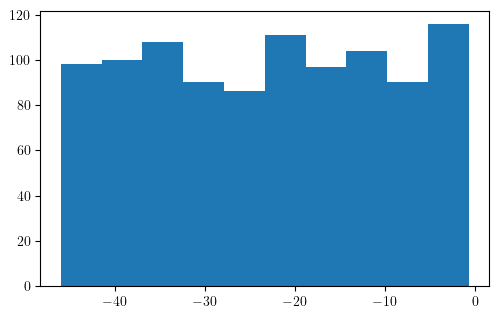

In [13]:
# plt.hist(np.random.uniform(np.log(1e-20) , np.log(5e-1),size=1000))

In [11]:
datasets,inj_pars

(['old_results_mcmc/MCMC_M1e+06_mu1e+01_p1.3e+01_e0.4_x-1.0_T2.0_seed26011996_nw32_nt1.h5',
  'old_results_mcmc/MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt1.h5',
  'old_results_mcmc/MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0_seed26011996_nw32_nt1.h5',
  'old_results_mcmc/MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5',
  'old_results_mcmc/MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5',
  'old_results_mcmc/MCMC_M5e+05_mu1e+01_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5'],
 [array([13.81551056, 10.        ,  0.9       , 12.76546704,  0.4       ,
          1.06828598,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
          1.57079633,  1.57079633,  0.        ]),
  array([13.81551056, 10.        ,  0.9       , 10.0977029 ,  0.4       ,
          4.2517377 ,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
          1.57079633,  1.57079633,  0.        ]),
  array([13.81551056, 10.        ,  0.9       ,  8.53753455,  0.1 

In [12]:
inj_pars = np.asarray(inj_pars)
add_T = np.ones(inj_pars.shape[0],dtype=int)*2
# np.hstack((inj_pars,add_T[None,:]))
inj_pars.shape,add_T[:,None].shape
run_vals = np.hstack((inj_pars,add_T[:,None]))
run_vals[1,-1]=4 # 4 years
run_vals[0,2]*=-1 # retrograde

In [13]:
run_vals

array([[13.81551056, 10.        , -0.9       , 12.76546704,  0.4       ,
         1.06828598,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
         1.57079633,  1.57079633,  0.        ,  2.        ],
       [13.81551056, 10.        ,  0.9       , 10.0977029 ,  0.4       ,
         4.2517377 ,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
         1.57079633,  1.57079633,  0.        ,  4.        ],
       [13.81551056, 10.        ,  0.9       ,  8.53753455,  0.1       ,
         5.12215988,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
         1.57079633,  1.57079633,  0.        ,  2.        ],
       [13.81551056, 10.        ,  0.9       ,  8.4589602 ,  0.4       ,
         5.13371517,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
         1.57079633,  1.57079633,  0.        ,  2.        ],
       [13.81551056, 50.        ,  0.9       , 12.76824883,  0.4       ,
        14.20953441,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
         1.57079633,  1.57

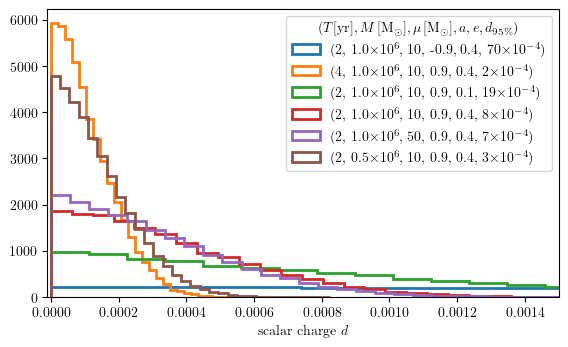

In [14]:
# plt.figure(figsize=(20,10))
plt.figure()
for el,lab in zip(samp_final,run_vals):
    d95 = np.quantile(el[:,-1], 0.95)
    Mhere = np.round(np.exp(lab[0]))
    plt.hist(el[:,-1],bins=30,density=True,
             label='('+str(int(lab[-1]))+', '+str(Mhere/1e6)+r'$\times 10^{6}$, '+str(int(lab[1]))+', '+str(lab[2])+', '+str(lab[4])+', '+str(int(d95*1e4))+r'$\times 10^{-4}$'+')', 
             # weights=el[:,-1],
             histtype='step', lw=2)
plt.xlabel('scalar charge $d$')
plt.legend(title=r'$(T [{\rm yr}], M \, [{\rm M}_\odot], \mu \, [{\rm M}_\odot], a, e, d_{95\%})$')
plt.tight_layout()
plt.xlim(-0.00001,0.0015)
plt.savefig('scalar_charge_bounds.pdf')

In [52]:
# len(names_txt[1:]),len(samp_final[1:]),len(names_txt)

In [53]:
names_txt = [ el.split('results_mcmc/')[-1].split('_seed26011996_nw32_nt1.h5')[0] for el in datasets]
print(len(samp_final[1:]),len(names_txt[1:]))
header = 'lnM, mu, a, p0, e0, D_L, costhetaS, phiS, costhetaK, phiK, Phi_phi0, Phi_r0, d'
for nn,ss in zip(names_txt[1:],samp_final[1:]):
    print(nn)
    np.savetxt(nn+'.txt',ss,header=header)

5 5
MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0
MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0
MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0
MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0
MCMC_M5e+05_mu1e+01_p1.2e+01_e0.4_x1.0_T2.0


In [54]:
datasets

['results_mcmc/MCMC_M1e+06_mu1e+01_p1.3e+01_e0.4_x-1.0_T2.0_seed26011996_nw32_nt1.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt1.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0_seed26011996_nw32_nt1.h5',
 'results_mcmc/MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5',
 'results_mcmc/MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5',
 'results_mcmc/MCMC_M5e+05_mu1e+01_p1.2e+01_e0.4_x1.0_T2.0_seed26011996_nw32_nt1.h5']

In [55]:
import zipfile
# List of files to be zipped
files_to_zip = [nn+'.txt' for nn,ss in zip(names_txt[1:],samp_final[1:])]

# Name of the output ZIP archive
output_zip_name = 'samples_different_runs.zip'

# Open the output ZIP archive in write mode
with zipfile.ZipFile(output_zip_name, 'w') as zipf:
    # Add each file to the archive
    for file in files_to_zip:
        zipf.write(file)

# Remove the original files
# for file in files_to_zip:
#     os.remove(file)

print(f'Successfully created {output_zip_name}')

Successfully created samples_different_runs.zip


In [56]:
# zip compressed_archive.zip MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0.txt MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0.txt MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0.txt

# Map to theory
The mapping between the scalar charge d and the coupling constant $\alpha$ is
$$
y = \sqrt{\alpha} \\
d = \frac{y^2}{2 \mu^2} \\
\sqrt{2 \, d} \mu = y \\
\frac{\mu}{\sqrt{d}} {\rm d} d = {\rm d} y = y \, {\rm d} \log y 
$$

In [15]:
!ls ./

bf_mcmc.sh
covariance.npy
lakshmi_mcmc.sh
mcmc_BF.py
MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0.txt
MCMC_M1e+06_mu1e+01_p8.5_e0.1_x1.0_T2.0.txt
MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0.txt
MCMC_M1e+06_mu5e+01_p1.3e+01_e0.4_x1.0_T2.0.txt
MCMC_M5e+05_mu1e+01_p1.2e+01_e0.4_x1.0_T2.0.txt
mcmc.py
old_results_mcmc
output_Tobs2_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.1_x01.0_charge0.0_dev7_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev2_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M5e5_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev3_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs2_dt15.0_M5e5_mu5_a0.95_p013.0_e00.4_x01.0_charge0.0_dev4_nwalkers64_ntemps1_nsteps500000.txt
output_Tobs4_dt15.0_M1e6_mu1e1_a0.95_p013.0_e00.4_x01.0_charge0.0_dev1_nwalkers64_ntemps1_nsteps500000.txt
PlayGroundScalarWaveforms.ipynb
postprocess.ipynb
results_mcmc
run_mcmc.sh
samples_different_runs.zip
scalar_charge_bounds.pdf
test


In [16]:
datain = np.loadtxt('./MCMC_M1e+06_mu1e+01_p8.5_e0.4_x1.0_T2.0.txt')
datain.shape

(368064, 13)

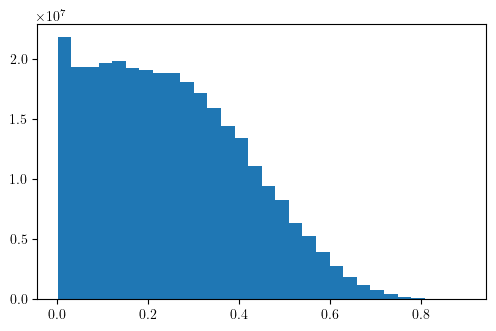

In [17]:
mu = datain[:,1]
d = datain[:,-1]
w = mu / np.sqrt(d)
y = np.sqrt(2*d)*mu*1.477
plt.figure()
plt.hist(y, weights=w, bins=30)#  
plt.show()

If you want to do in $\log \sqrt{\alpha}$ then you need to use an additional weight of $1/y$

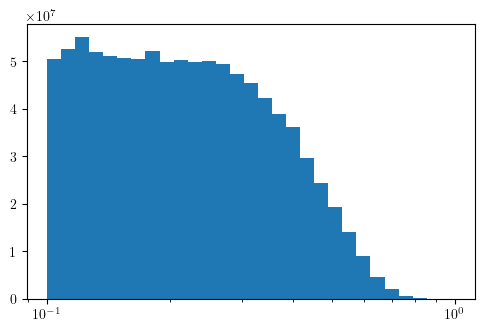

In [18]:
plt.figure()
plt.hist(y, weights=w/y, bins=10**np.linspace(-1,0,num=30))
plt.semilogx()
plt.show()

In [19]:
import matplotlib as mpl

default_width = 5.78853 # in inches
default_ratio = (np.sqrt(5.0) - 1.0) / 2.0 # golden mean

mpl.rcParams.update({
    "text.usetex": True,
    "pgf.texsystem": 'pdflatex',
    "pgf.rcfonts": False,
    "font.family": "serif",
    "figure.figsize": [default_width, default_width * default_ratio],
})
mpl.rcParams.update({
    "text.usetex": True,
    "pgf.texsystem": 'pdflatex',
    "pgf.rcfonts": False,
    "font.family": "serif",
    "figure.figsize": [default_width, default_width * default_ratio],
  'legend.fontsize': 10,
  'xtick.labelsize': 15,
  'ytick.labelsize': 15,
# "axes.formatter.min_exponent": 1
"axes.formatter.offset_threshold": 10
})


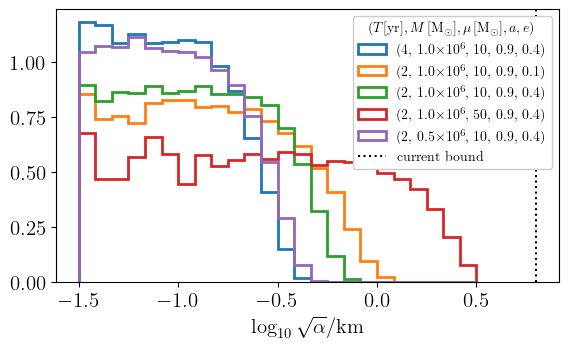

In [20]:
plt.figure()
for el,lab in zip(samp_final[1:],run_vals[1:] ):
    mu = el[:,1]
    d = el[:,-1]
    w = mu / np.sqrt(d)
    y = np.sqrt(2*d)*mu*1.477

    d95 = np.quantile(y, 0.95)
    Mhere = np.round(np.exp(lab[0]))
    plt.hist( np.log10(y),weights=w/y, bins=np.linspace(-1.5,0.5,num=25),#bins=10**np.linspace(-1.5,0.5,num=30),
             density=True,
             label='('+str(int(lab[-1]))+', '+str(Mhere/1e6)+r'$\times 10^{6}$, '+str(int(lab[1]))+', '+str(lab[2])+', '+str(lab[4])+')', 
             histtype='step', lw=2)
plt.xlabel(r'$\log_{10} \sqrt{\alpha} / {\rm km} $',size=15)

plt.tight_layout()
plt.axvline(0.8,label='current bound',color='k',linestyle=':')
plt.legend(title=r'$(T [{\rm yr}], M \, [{\rm M}_\odot], \mu \, [{\rm M}_\odot], a, e)$',framealpha=1.0)
plt.savefig('alpha_bounds.pdf')


# Full corner plot

In [25]:
mpl.rcParams.update({
    "text.usetex": True,
    "pgf.texsystem": 'pdflatex',
    "pgf.rcfonts": False,
    "font.family": "serif",
    "figure.figsize": [default_width, default_width * default_ratio],
  'legend.fontsize': 40,
  'xtick.labelsize': 20,
  'ytick.labelsize': 20,
# "axes.formatter.min_exponent": 1
"axes.formatter.offset_threshold": 10
})



In [33]:
inj_pars[0]

array([13.81551056, 10.        ,  0.9       , 12.76546704,  0.4       ,
        1.06828598,  0.5       ,  1.04719755,  0.5       ,  1.04719755,
        1.57079633,  1.57079633,  0.        ])

In [34]:
truths = inj_pars[0]

CORNER_KWARGS = dict(
#     smooth=0.6,
    labels=[r'$\log (M/{\rm M}_\odot$)', r'$\mu / M_{\odot}$', r'$a$', r'$p_0 \, [M]$', r'$e_0$', 
            r'$D_L$',
            r"$\cos \theta_S$",r"$\phi_S$",
            r"$\cos \theta_K$",r"$\phi_K$",
           r'$\Phi_{\varphi 0}$', r'$\Phi_{r 0}$',
            r"$d$",
            # 'log-likelihood'
           ],
    bins=40,
    truths = truths,
    label_kwargs=dict(fontsize=35),
#     title_kwargs=dict(fontsize=13),
    levels=(1 - np.exp(-0.5), 1 - np.exp(-2), 1 - np.exp(-9 / 2.)),
    plot_density=False,
    plot_datapoints=False,
    fill_contours=False,
    show_titles=False,
    max_n_ticks=4,
    truth_color='k',
    labelpad=0.3,
)
import matplotlib.lines as mlines

def get_normalisation_weight(len_current_samples, len_of_longest_samples):
    return np.ones(len_current_samples) * (len_of_longest_samples / len_current_samples)


def overlaid_corner(samples_list, sample_labels, name_save=None, corn_kw=CORNER_KWARGS):
    """Plots multiple corners on top of each other"""
    # get some constants
    n = len(samples_list)
    _, ndim = samples_list[0].shape
    max_len = max([len(s) for s in samples_list])
    cmap = plt.cm.get_cmap('Set1',)
    colors = [cmap(i) for i in range(n)]#['black','red', 'royalblue']#

    plot_range = []
    for dim in range(ndim):
        plot_range.append(
            [
                min([min(samples_list[i].T[dim]) for i in range(n)]),
                max([max(samples_list[i].T[dim]) for i in range(n)]),
            ]
        )

    CORNER_KWARGS.update(range=plot_range)
    fig = corner.corner(
        samples_list[0],
        color=colors[0],
        weights=get_normalisation_weight(len(samples_list[0]), max_len),
        **CORNER_KWARGS
    )

    for idx in range(1, n):
        fig = corner.corner(
            samples_list[idx],
            fig=fig,
            weights=get_normalisation_weight(len(samples_list[idx]), max_len),
            color=colors[idx],
            **CORNER_KWARGS
        )

    plt.legend(
        handles=[
            mlines.Line2D([], [], color=colors[i], label=sample_labels[i])
            for i in range(n)
        ],
        fontsize=35, frameon=False,
        bbox_to_anchor=(0.5, ndim+1), 
        loc="upper right"
    )
    
#     fig.subplots_adjust(right=1.0,top=1.0)

    plt.subplots_adjust(left=-0.1, bottom=-0.1, right=None, top=None, wspace=None, hspace=0.15)

    if name_save is not None:
        plt.savefig(name_save+".pdf", pad_inches=0.2, bbox_inches='tight')
    else:
        plt.show()


In [37]:
name_mcmc = [el.split('downsample1_')[-1].split('.h5')[0] for el in datasets]


'results_mcmc/MCMC_M1e+06_mu1e+01_p1e+01_e0.4_x1.0_T4.0_seed26011996_nw32_nt1'

/tmp/ipykernel_659558/2952301036.py:38: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('Set1',)


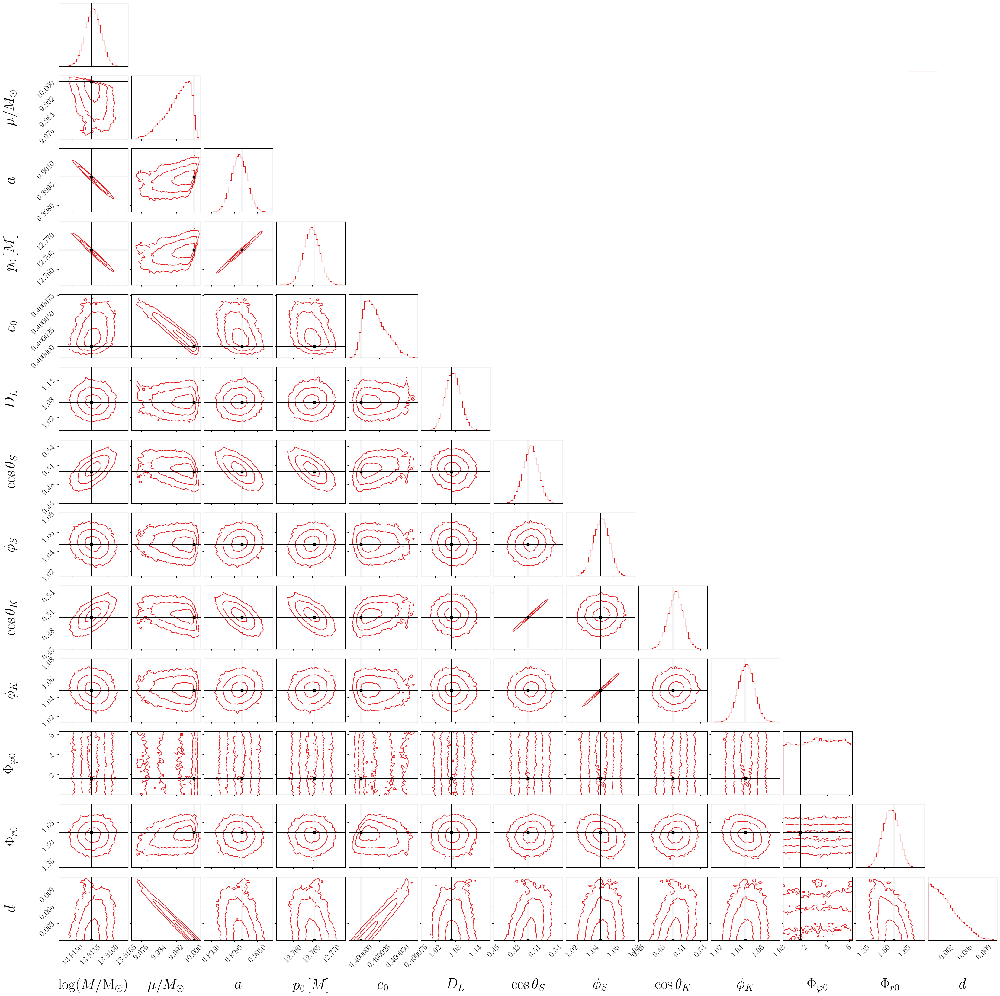

In [38]:
overlaid_corner([samp_final[0]], [" "],name_save=name_mcmc[1]+'_posteriors.pdf')

In [39]:
from scipy.stats import entropy
set_num = [[0,1],[0,2],[2,1]]
for ii in range(3):
    for var in range(6):
        bins = np.linspace(samp_final[0][:,var].min(),samp_final[0][:,var].max(),num=20)
        counts1,_ = np.histogram(samp_final[set_num[ii][0]][:,var],bins=bins)
        counts2,_ = np.histogram(samp_final[set_num[ii][1]][:,var],bins=bins)
        print(entropy(counts2,qk=counts1))

7.511629491187708e-05
0.00022136145317279798
0.0002133622926115147
0.00012687262007742486
0.00010547404460524276
0.00012788585227911471
0.0003895700901878787
8.259397263103794e-05
6.820638703927235e-05
0.00027832986979116873
9.609976264535623e-05
6.874366367275577e-05
0.0002418487936459391
0.00015093808003734184
0.0001859957684406602
0.00012475519282710554
0.0001129106530749433
0.00011284880805310517


# Downsampled

In [40]:
CORNER_KWARGS

{'labels': ['$\\log (M/{\\rm M}_\\odot$)',
  '$\\log (\\mu / M)$',
  '$p_0 \\, [M]$',
  '$e_0$',
  '$\\Phi_{\\varphi 0}$',
  '$\\Phi_{r 0}$',
  'log-likelihood'],
 'bins': 40,
 'truths': [15.115713592242255,
  -9.438760095027266,
  13.709101864726545,
  0.5794130830706371,
  1.0471975511965976,
  1.0471975511965976,
  0.0],
 'label_kwargs': {'fontsize': 35},
 'levels': (0.3934693402873666, 0.8646647167633873, 0.9888910034617577),
 'plot_density': False,
 'plot_datapoints': False,
 'fill_contours': False,
 'show_titles': False,
 'max_n_ticks': 4,
 'truth_color': 'k',
 'labelpad': 0.3,
 'range': [[15.115687267052175, 15.115739420764386],
  [-9.438829404512905, -9.438693633194458],
  [13.708922936633092, 13.709292113991944],
  [0.5793977942631167, 0.5794294904687305],
  [0.7730447739530297, 1.301019219849867],
  [0.9310958033331248, 1.1544861185232909],
  [-19.591033041293453, -0.02952779622263154]]}

In [41]:
lst = ['solid','dashed','dashdot']
CORNER_KWARGS = dict(
#     smooth=0.6,
    labels=[r'$\log (M/{\rm M}_\odot$)', r'$\log (\mu / M)$', r'$p_0 \, [M]$', r'$e_0$', 
           r'$\Phi_{\varphi 0}$', r'$\Phi_{r 0}$','log-likelihood'
           ],
    bins=40,
    truths = truths,
    label_kwargs=dict(fontsize=35),
#     title_kwargs=dict(fontsize=13),
    levels=(1 - np.exp(-0.5), 1 - np.exp(-2), 1 - np.exp(-9 / 2.)),
    plot_density=False,
    plot_datapoints=False,
    fill_contours=False,
    show_titles=False,
    max_n_ticks=4,
    truth_color='k',
    labelpad=0.3,
)

def overlaid_corner(samples_list, sample_labels, name_save=None, corn_kw=CORNER_KWARGS):
    """Plots multiple corners on top of each other"""
    # get some constants
    n = len(samples_list)
    _, ndim = samples_list[0].shape
    max_len = max([len(s) for s in samples_list])
    cmap = plt.cm.get_cmap('tab10',)
    colors = [cmap(i) for i in range(n)]#['black','red', 'royalblue']#

    plot_range = []
    for dim in range(ndim):
        plot_range.append(
            [
                min([min(samples_list[i].T[dim]) for i in range(n)]),
                max([max(samples_list[i].T[dim]) for i in range(n)]),
            ]
        )

    CORNER_KWARGS.update(range=plot_range)
    
    fig = corner.corner(
        samples_list[0],
        color=colors[0],
        weights=get_normalisation_weight(len(samples_list[0]), max_len),
        **CORNER_KWARGS
    )

    for idx in range(1, n):
        
        
        CORNER_KWARGS['contour_kwargs'] = {"linestyles":lst[idx],"color":colors[idx],"linewidths":2}
        CORNER_KWARGS['hist_kwargs'] = {"ls":lst[idx],"color":colors[idx]}

        fig = corner.corner(
            samples_list[idx],
            fig=fig,
            weights=get_normalisation_weight(len(samples_list[idx]), max_len),
            color=colors[idx],
            **CORNER_KWARGS
        )

    leg=plt.legend(
        handles=[
            mlines.Line2D([], [], color=colors[i], label=sample_labels[i],linestyle=lst[i])
            for i in range(n)
        ],
        fontsize=35, frameon=False,
        bbox_to_anchor=(0.5, ndim+1.0), 
        loc="upper right",
        title=r'$(f_{\rm max} \, [\rm{mHz}], N_f,\rm{likelihood} \, \rm{speed} \{\rm{CPU,GPU}\} \,[\rm{s}])=$',
        title_fontsize=35,
    )

    plt.subplots_adjust(left=-0.1, bottom=-0.1, right=None, top=None, wspace=None, hspace=0.15)

    if name_save is not None:
        plt.savefig(name_save+".pdf", pad_inches=0.2, bbox_inches='tight')
    else:
        plt.show()



In [42]:
datasets = sorted(glob.glob('results/downsampled_mcmc/*.h5'))+ glob.glob('results/MCMC_*window_flagFalse*.h5')
datasets
downsample_value = np.asarray([datasets[ii].split('_downsample')[1].split('_inject')[0] for ii in range(len(datasets))],dtype=int)
datasets = [datasets[ii] for ii in np.argsort(downsample_value)]
datasets

['results/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt1_downsample0_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5',
 'results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample1_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5',
 'results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample10_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5',
 'results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample100_injectFD1_usegpuFalse_templatefd_window_flagFalse.h5',
 'results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample1000_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5',
 'results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample10000_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5']

results/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt1_downsample0_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.40970007, 0.41007648, 0.4101183 , 0.41065304, 0.41119376,
        0.40929677, 0.40924897, 0.41081138, 0.41074565, 0.4118241 ,
        0.40965824, 0.4108771 , 0.4094073 , 0.41003465, 0.4109249 ,
        0.41003764, 0.41153731, 0.40991217, 0.41086216, 0.40987632,
        0.40914142, 0.41128338, 0.41001075, 0.40929378, 0.40811973,
        0.41033339, 0.41082333, 0.41015116, 0.41031248, 0.41046783,
        0.41093983, 0.40933262]])}}


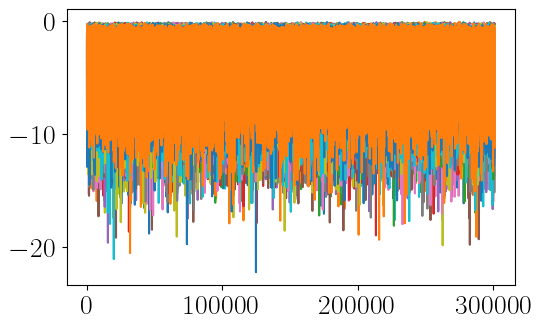

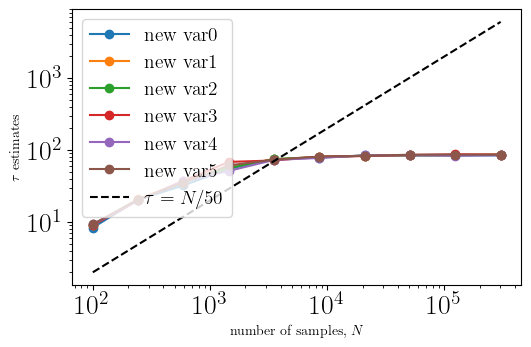

results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample1_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.40845315, 0.41289304, 0.41015279, 0.41696873, 0.41193916,
        0.41336131, 0.41245946, 0.41053435, 0.40928563, 0.4087133 ,
        0.41029154, 0.40916422, 0.41001405, 0.40926828, 0.40907751,
        0.41070778, 0.40909485, 0.40952843, 0.41561595, 0.41254618,
        0.40692693, 0.40925094, 0.40838377, 0.40588633, 0.40708302,
        0.40798488, 0.41145355, 0.41032623, 0.41601485, 0.4123554 ,
        0.41077716, 0.41056904],
       [0.26337606, 0.26811079, 0.26238749, 0.26108673, 0.26035831,
        0.26476352, 0.26429525, 0.26295982, 0.26342809, 0.26665395,
        0.26384433, 0.26648051, 0.26245686, 0.26514508, 0.26341074,
        0.26464212, 0.2640351 , 0.26594287, 0.26346277, 0.26294247,
        0.26382698, 0.26306388, 0.257514  , 0.26374027, 0.26570006,
        0.26044

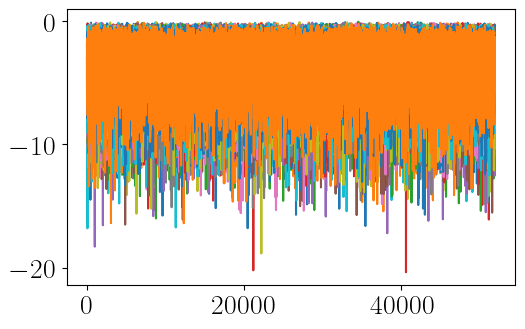

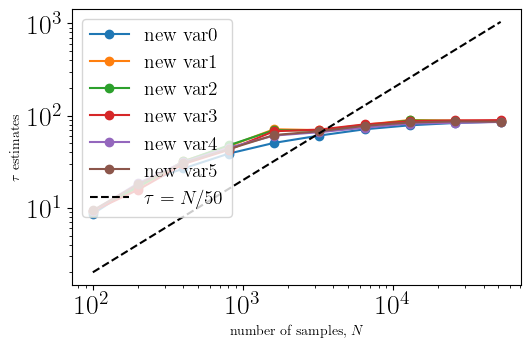

results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample10_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.40123491, 0.39939143, 0.39772563, 0.40056859, 0.40248981,
        0.40083512, 0.40290071, 0.40424445, 0.40066854, 0.40209002,
        0.40417782, 0.39976901, 0.39821427, 0.40176797, 0.40376692,
        0.40067965, 0.40228992, 0.40156807, 0.40673204, 0.40161249,
        0.39928038, 0.40124602, 0.40256755, 0.40203449, 0.39968017,
        0.40186791, 0.39980233, 0.40077959, 0.4051773 , 0.40027985,
        0.40306729, 0.40295623],
       [0.26140793, 0.26610548, 0.26286273, 0.26075272, 0.2609304 ,
        0.26256288, 0.26380668, 0.26024187, 0.26631648, 0.26479505,
        0.26232967, 0.2628072 , 0.26276278, 0.26157451, 0.26380668,
        0.2632181 , 0.26327362, 0.26693838, 0.26680511, 0.26166335,
        0.26576121, 0.26360678, 0.25846502, 0.26231857, 0.26298489,
        0.2602

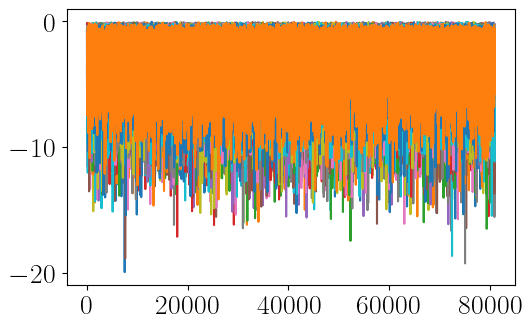

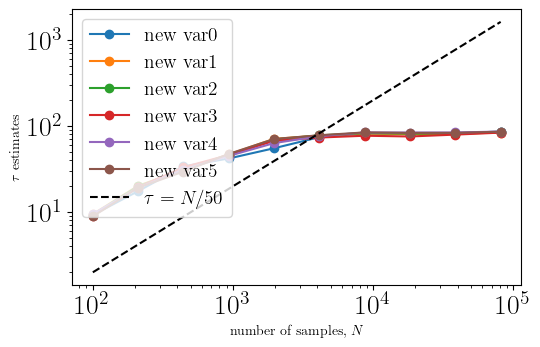

results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample100_injectFD1_usegpuFalse_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.46588883, 0.46780497, 0.46404857, 0.46901916, 0.46956934,
        0.46583191, 0.46755834, 0.46600266, 0.46900019, 0.46304307,
        0.4702713 , 0.47104914, 0.46674255, 0.46985392, 0.46748245,
        0.46317587, 0.46858281, 0.46583191, 0.47011952, 0.46755834,
        0.46725479, 0.4670461 , 0.46994878, 0.46585088, 0.46826029,
        0.46562322, 0.46736862, 0.46987289, 0.46970214, 0.46960729,
        0.46867767, 0.46970214],
       [0.26319484, 0.26721685, 0.26110795, 0.26143047, 0.26044394,
        0.26475052, 0.26573705, 0.26224625, 0.26374502, 0.26744451,
        0.26359325, 0.26687536, 0.26156327, 0.26511098, 0.26397268,
        0.26494024, 0.26408651, 0.26605957, 0.26499715, 0.26298615,
        0.26431417, 0.26338456, 0.25750332, 0.26431417, 0.26638209,
        0.26

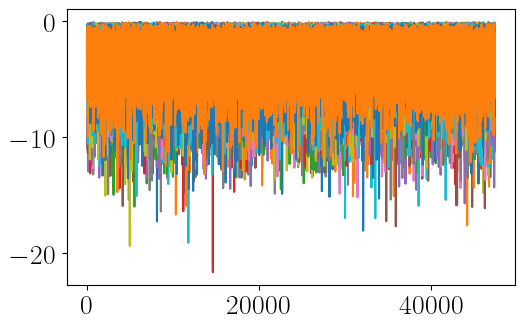

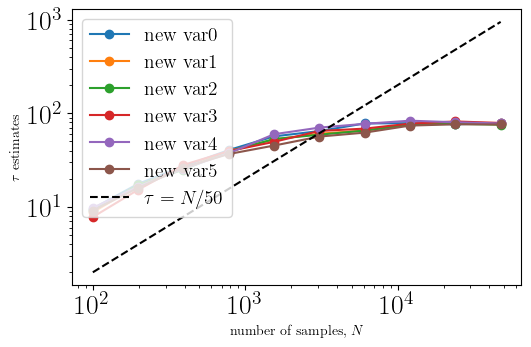

results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample1000_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.5057735 , 0.50975204, 0.50558845, 0.5069208 , 0.50797557,
        0.50673575, 0.50817913, 0.50780903, 0.51054774, 0.50523686,
        0.50673575, 0.50856773, 0.50592154, 0.50777202, 0.50529238,
        0.50351591, 0.50969652, 0.50534789, 0.51117691, 0.50771651,
        0.50427461, 0.50723538, 0.50721688, 0.50518135, 0.50412657,
        0.50568098, 0.50938194, 0.51058475, 0.50980755, 0.51043671,
        0.50910437, 0.5080681 ],
       [0.26326795, 0.26767209, 0.26186158, 0.26149149, 0.25993708,
        0.26478534, 0.26517395, 0.26260178, 0.26410067, 0.26674685,
        0.26393412, 0.26685788, 0.26123242, 0.26524796, 0.26397113,
        0.26493338, 0.26367506, 0.26633975, 0.26448927, 0.26332346,
        0.26432272, 0.26321244, 0.2580866 , 0.26400814, 0.26550703,
        0.26

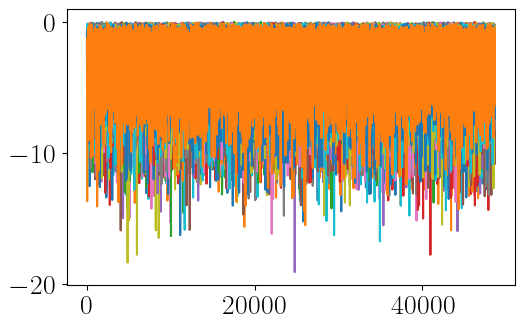

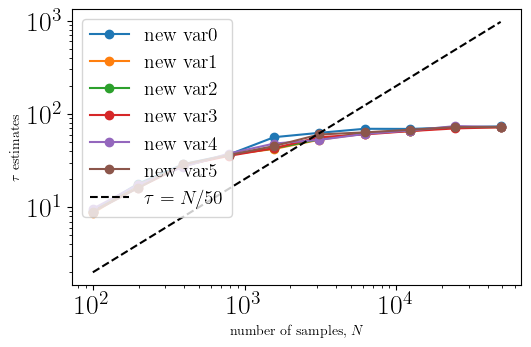

results/downsampled_mcmc/MCMC_M3.7e+06_mu2.9e+02_p1.4e+01_e0.58_T4.0_eps0.01_seed2601996_nw32_nt2_downsample10000_injectFD1_usegpuTrue_templatefd_window_flagFalse.h5
{'StretchMove_0': {'acceptance_fraction': array([[0.51068695, 0.51638543, 0.51503919, 0.51540802, 0.51669894,
        0.51487321, 0.51662517, 0.51271554, 0.51762102, 0.51026279,
        0.51728907, 0.51448594, 0.51195943, 0.51610881, 0.51188566,
        0.51284463, 0.51706777, 0.51465191, 0.52145689, 0.51472568,
        0.51171969, 0.51457815, 0.51603504, 0.51112955, 0.51684647,
        0.51166436, 0.51780544, 0.51621946, 0.5215491 , 0.5182296 ,
        0.51531581, 0.51701245],
       [0.26441678, 0.26841863, 0.26174274, 0.26045182, 0.26319963,
        0.26419548, 0.26539419, 0.26321807, 0.26567082, 0.2668142 ,
        0.26248041, 0.26439834, 0.2621669 , 0.26502536, 0.26377132,
        0.26661134, 0.26410327, 0.26522822, 0.26596588, 0.26231443,
        0.26502536, 0.26137391, 0.25626556, 0.26316275, 0.26651913,
        0.2

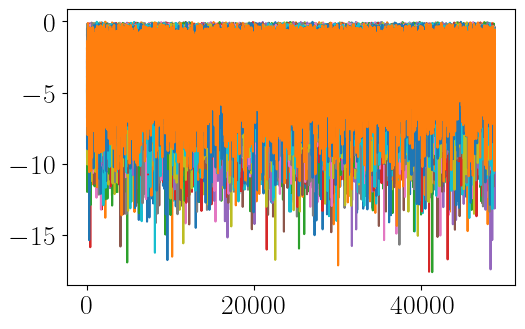

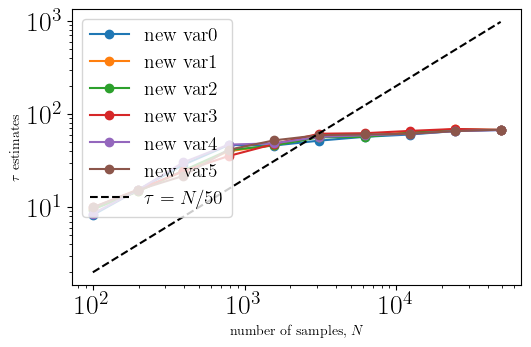

In [43]:
# filename = 'emri_M1e+06_mu1e+01_p9.5_e0.35_T1.0_eps1e-05_seed2601996_injectFD1_templatefd.h5'
temp=0

samp_final_ds = []
for filename in datasets:
    file  = HDFBackend(filename)
    print(filename)
    print(file.get_move_info())
    max_iter = file.iteration
    burn = int(max_iter*0.1)
    thin = 1
    ll = file.get_log_like(discard=burn, thin=thin)
    mask = np.arange(32)#[file.get_move_info()['StretchMove_0']['acceptance_fraction'][0]>0.1]
    plt.figure()
    [plt.plot(ll[:,temp,walker],'-',label=f'{walker}') for walker in mask]
    plt.show()
    
    # get samples
    inds = file.get_inds(discard=burn, thin=thin)['emri']
    samp = file.get_chain(discard=burn, thin=thin)['emri'][:,temp,mask,...]
    get_autocorr_plot(samp[:,:,0,:])
    logl = ll[:,temp,mask,...]



    samp_final_ds.append( np.hstack((samp[inds[:,temp,mask,...]],logl[inds[:,temp,mask,0],None])) )

In [44]:
name_ds = [f'Downsampling factor '+ datasets[ii].split('_downsample')[1].split('_inject')[0] for ii in range(len(datasets))]
name_ds

['Downsampling factor 0',
 'Downsampling factor 1',
 'Downsampling factor 10',
 'Downsampling factor 100',
 'Downsampling factor 1000',
 'Downsampling factor 10000']

In [45]:
name_ds[0]=r'$(50,6311631,\{4.26, 0.061\})$'
# name_ds[1]=r'$f_{\rm max}=6.3$ mHz with $N_f=3.55443  \times 10^{5}$, CPU likelihood speed = $2.3$ s'
# name_ds[2]=r'$f_{\rm max}=6.3$ mHz with $N_f=3.5544  \times 10^{4}$, CPU likelihood speed = $0.55$ s'
name_ds[3]=r'$(2.8,3554,\{0.34, 0.029\})$'
name_ds[5]=r'$(2.8,35,\{0.32,0.029\})$'

In [46]:
6311631/2

3155815.5

In [47]:
ind = np.asarray([0,3,5])

/data/lsperi/miniconda3/envs/fd_env/lib/python3.7/site-packages/corner/core.py:675: UserWarning: The following kwargs were not used by contour: 'color'
  ax.contour(X2, Y2, H2.T, V, **contour_kwargs)


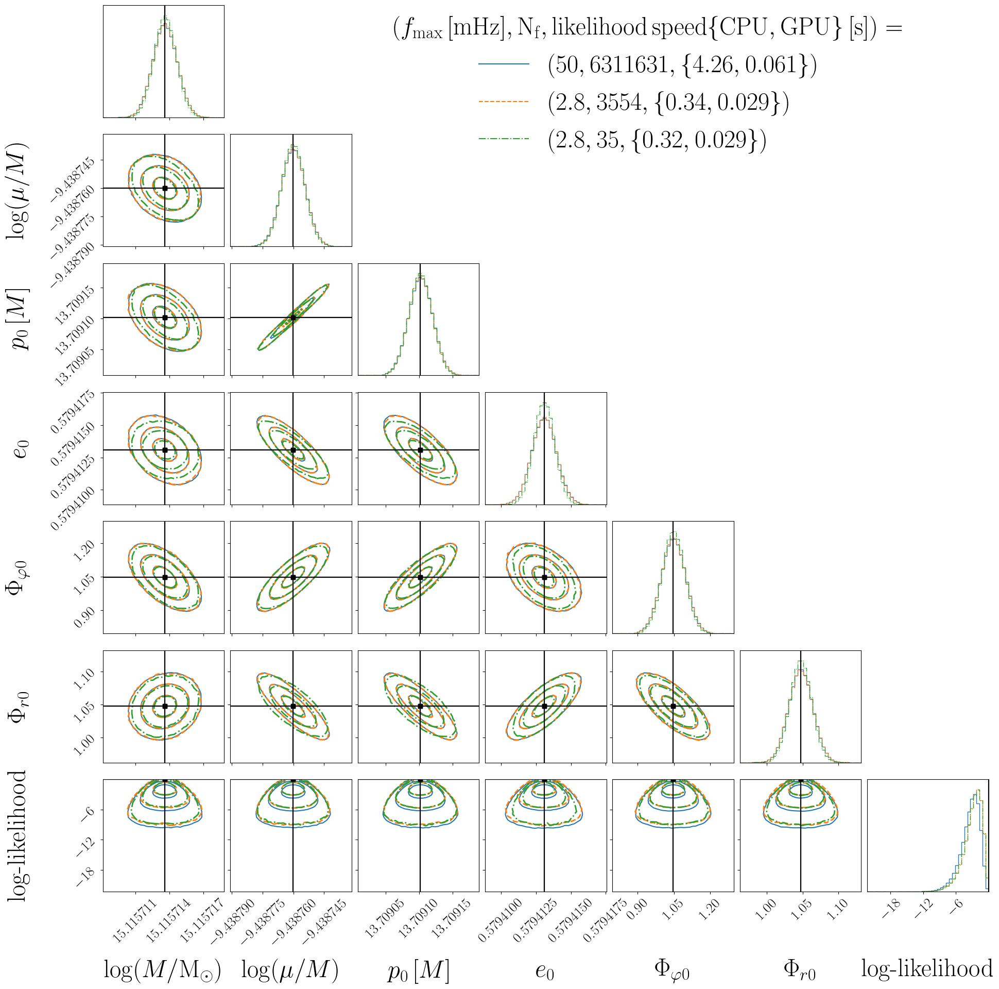

In [48]:
overlaid_corner([samp_final_ds[el] for el in ind], [name_ds[el] for el in ind], name_save='figures/downsampling_posterior_comparison_intrinsic')


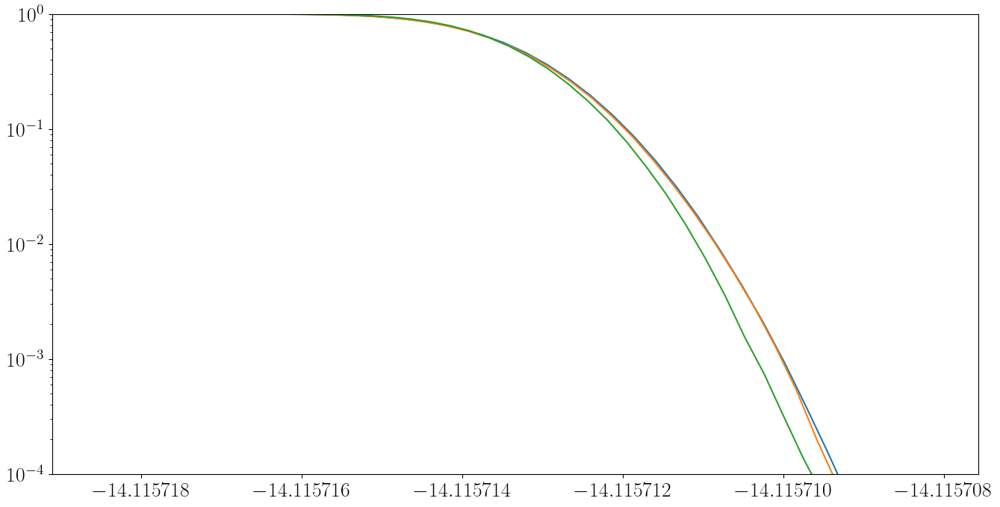

In [49]:
plt.figure(figsize=(16,8))
for el in [samp_final_ds[el] for el in ind]:
    # some fake data
    data = el[:,0]
    # evaluate the histogram
    values, base = np.histogram(data, bins=40, density=True)
    #evaluate the cumulative
    cumulative = np.cumsum(values)/np.sum(values)
    # plot the cumulative function
    plt.semilogy(1-base[:-1], cumulative)

plt.ylim(1e-4,1)
plt.show()

In [50]:
from scipy.stats import entropy
set_num = [[0,ii] for ii in range(1,len(samp_final_ds))]
for ii in range(len(set_num)):
    print('----------------------')
    print("set", name_ds[ii+1])
    for var in range(6):
        bins = np.linspace(samp_final[0][:,var].min(),samp_final[0][:,var].max(),num=20)
        counts1,_ = np.histogram(samp_final_ds[set_num[ii][0]][:,var],bins=bins)
        counts2,_ = np.histogram(samp_final_ds[set_num[ii][1]][:,var],bins=bins)
        print(entropy(counts2,qk=counts1))

----------------------
set Downsampling factor 1
0.00023796002057560898
9.841256959433918e-05
0.00016980074092120385
inf
0.00030432489827367606
inf
----------------------
set Downsampling factor 10
5.325679443848244e-06
inf
inf
6.94263739468735e-05
5.257522231821408e-05
9.995924752156836e-05
----------------------
set $(2.8,3554,\{0.34, 0.029\})$
4.324902052224209e-05
0.00010395933631267328
0.00014645790103987597
2.9483372204979066e-05
0.00011441992234895251
6.404528417620709e-05
----------------------
set Downsampling factor 1000
9.219501564009845e-05
0.002655723565545793
0.0016091184948220632
0.005290266151157734
7.995085702917456e-05
0.0004713484434050297
----------------------
set $(2.8,35,\{0.32,0.029\})$
0.0036553648406397504
0.0015790483717335081
0.0009637182627011279
0.017506185090799934
0.005448438358412908
0.007385915369865548


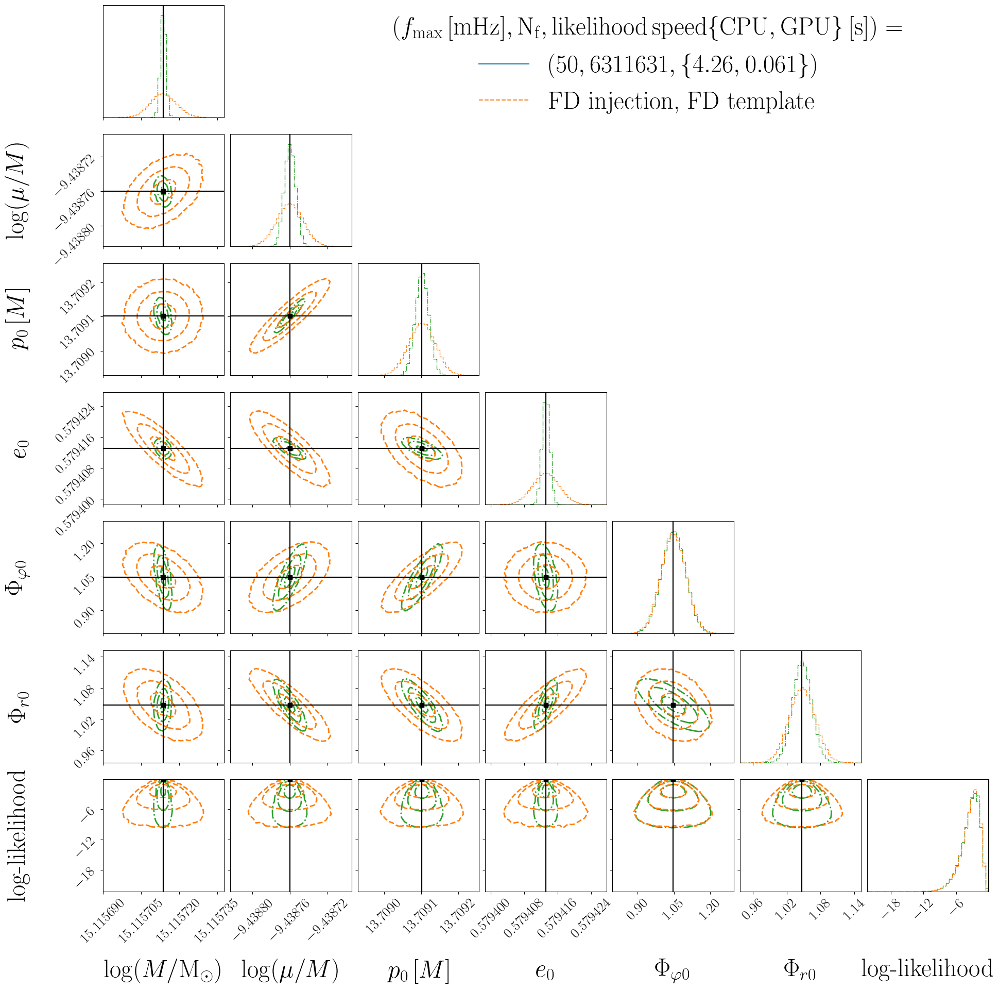

In [51]:
overlaid_corner([samp_final_ds[0],samp_final[2]],
                [name_ds[0],name_mcmc[2]]
               )

In [52]:
for ii in range(7):
    print(np.std(samp_final[0][:,ii]) / np.std(samp_final_ds[0][:,ii]))

4.870860099476719
2.428448969445232
1.9802361128257857
3.6429631977982795
1.037062119977268
1.3704079306364105
0.9760932161688094
